In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray', vmin=-0.5, vmax=0.5)  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:06<01:46,  6.25s/it]

Loading dataset:  11%|█         | 2/18 [00:16<02:16,  8.51s/it]

Loading dataset:  17%|█▋        | 3/18 [00:22<01:51,  7.43s/it]

Loading dataset:  22%|██▏       | 4/18 [00:28<01:37,  6.94s/it]

Loading dataset:  28%|██▊       | 5/18 [00:36<01:33,  7.17s/it]

Loading dataset:  33%|███▎      | 6/18 [00:44<01:28,  7.42s/it]

Loading dataset:  39%|███▉      | 7/18 [00:50<01:16,  6.94s/it]

Loading dataset:  44%|████▍     | 8/18 [00:58<01:12,  7.28s/it]

Loading dataset:  50%|█████     | 9/18 [01:06<01:07,  7.54s/it]

Loading dataset:  56%|█████▌    | 10/18 [01:12<00:56,  7.09s/it]

Loading dataset:  61%|██████    | 11/18 [01:17<00:45,  6.56s/it]

Loading dataset:  67%|██████▋   | 12/18 [01:30<00:50,  8.49s/it]

Loading dataset:  72%|███████▏  | 13/18 [01:36<00:39,  7.80s/it]

Loading dataset:  78%|███████▊  | 14/18 [01:43<00:29,  7.45s/it]

Loading dataset:  83%|████████▎ | 15/18 [01:53<00:24,  8.33s/it]

Loading dataset:  89%|████████▉ | 16/18 [02:00<00:15,  7.92s/it]

Loading dataset:  94%|█████████▍| 17/18 [02:07<00:07,  7.48s/it]

Loading dataset: 100%|██████████| 18/18 [02:12<00:00,  6.87s/it]

Loading dataset: 100%|██████████| 18/18 [02:12<00:00,  7.37s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:05<00:39,  5.62s/it]

Loading dataset:  25%|██▌       | 2/8 [00:18<00:58,  9.76s/it]

Loading dataset:  38%|███▊      | 3/8 [00:24<00:39,  7.93s/it]

Loading dataset:  50%|█████     | 4/8 [00:33<00:34,  8.72s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:39<00:23,  7.73s/it]

Loading dataset:  75%|███████▌  | 6/8 [00:47<00:15,  7.65s/it]

Loading dataset:  88%|████████▊ | 7/8 [00:54<00:07,  7.62s/it]

Loading dataset: 100%|██████████| 8/8 [01:03<00:00,  7.79s/it]

Loading dataset: 100%|██████████| 8/8 [01:03<00:00,  7.89s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /old_Users/tgafrick/RA4/jobs/job10/Models exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=55` in the `DataLoader` to improve performance.


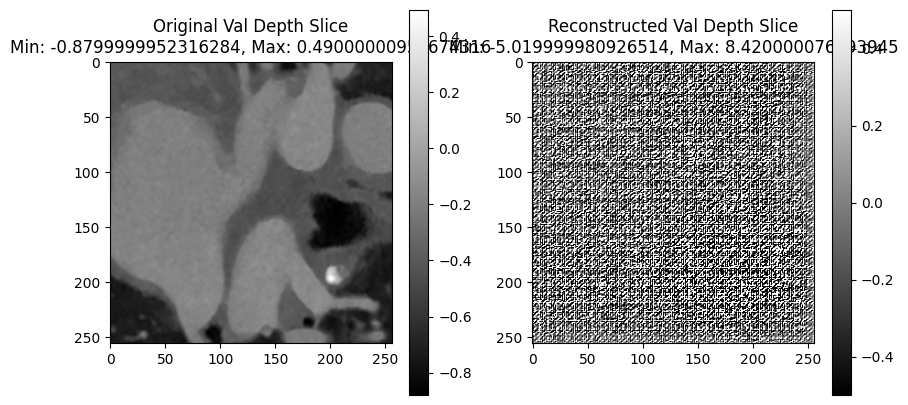

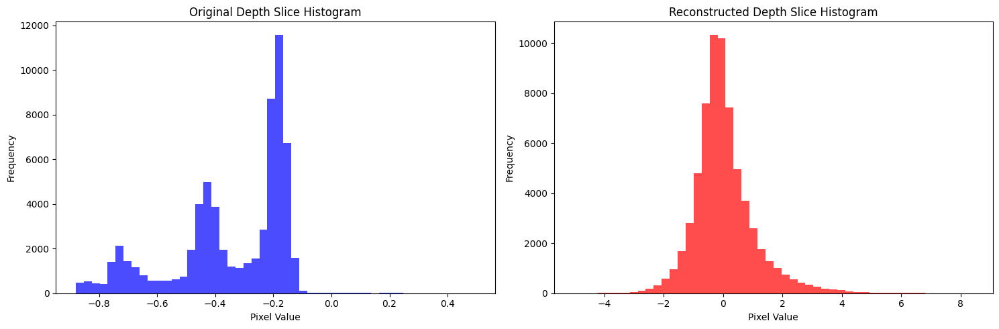

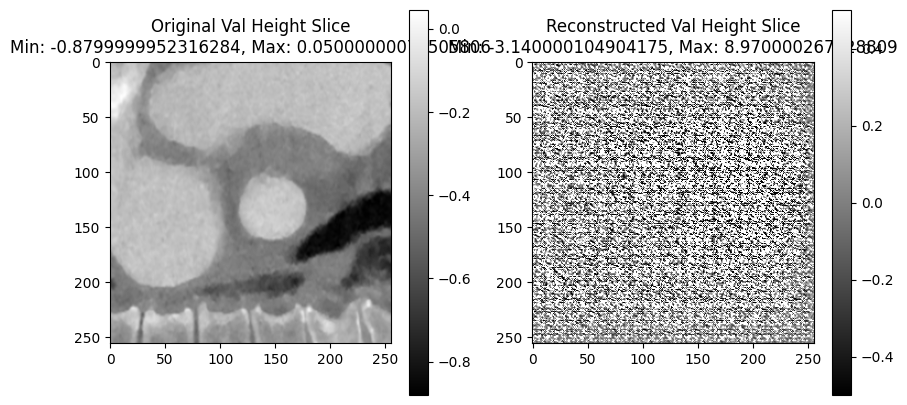

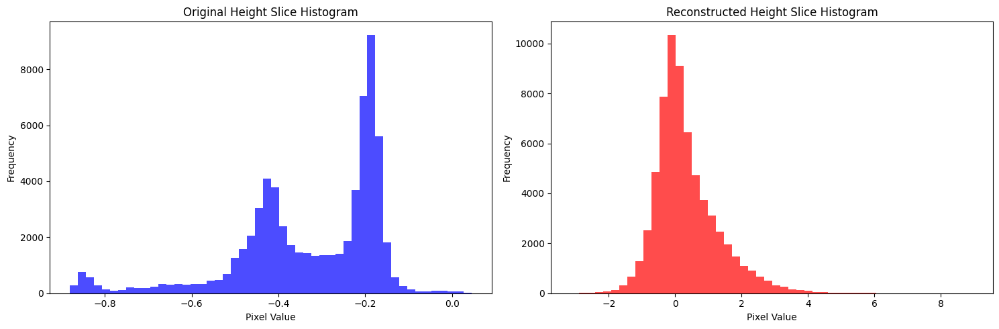

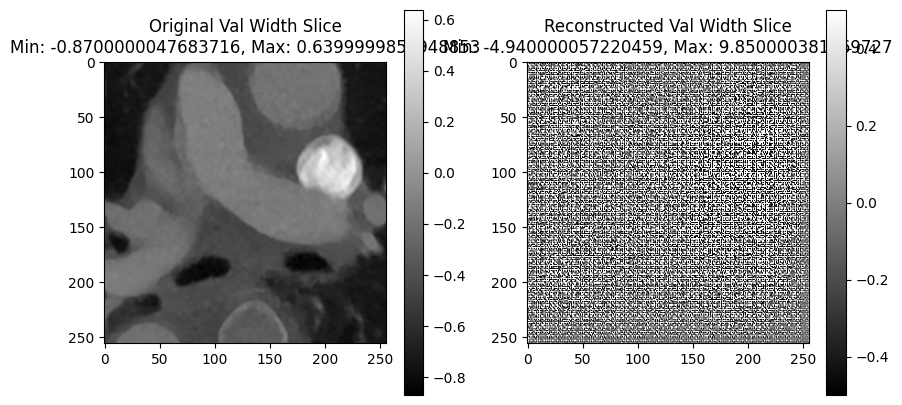

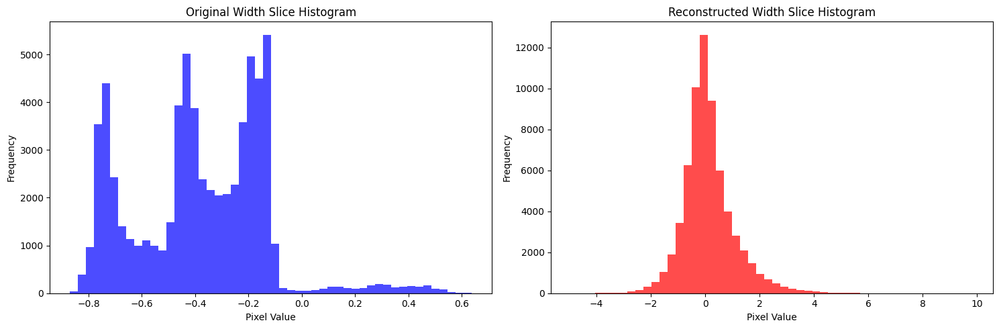

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=55` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

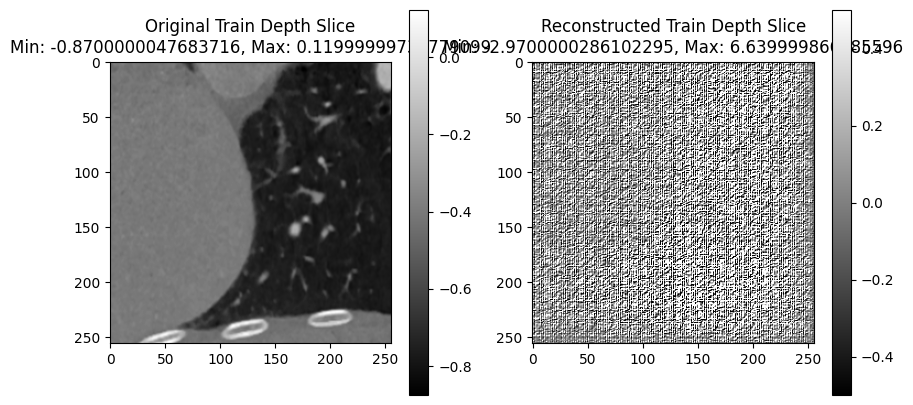

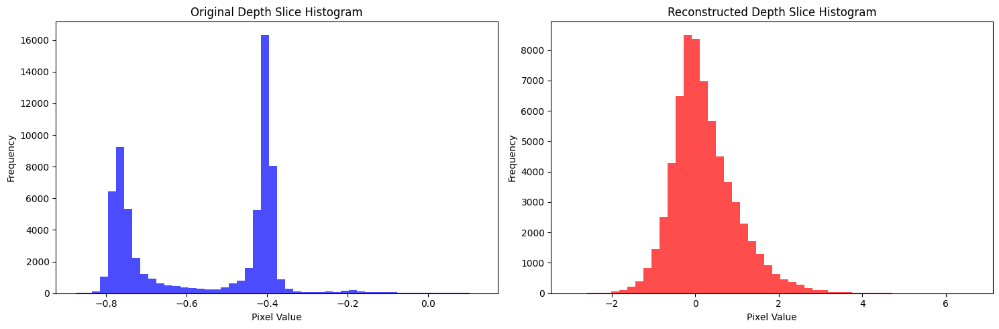

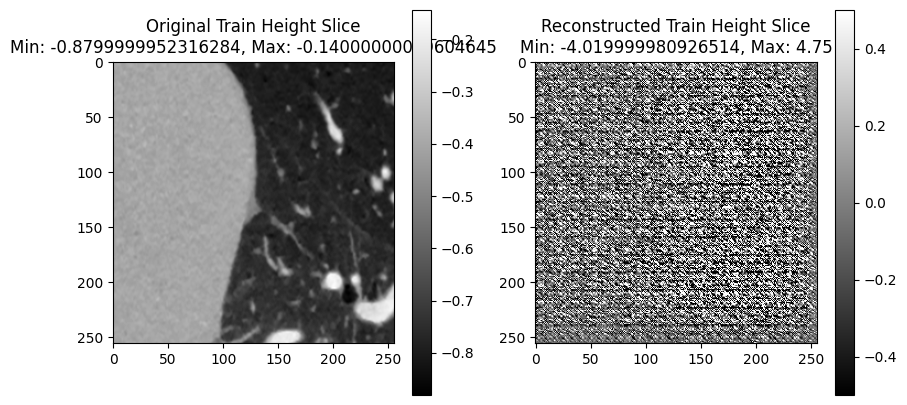

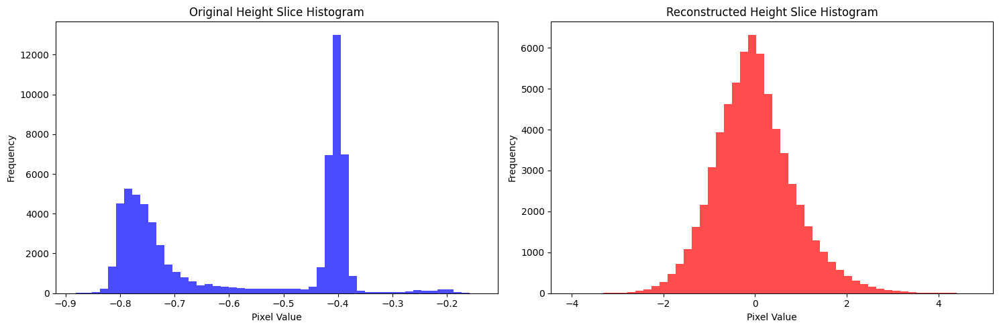

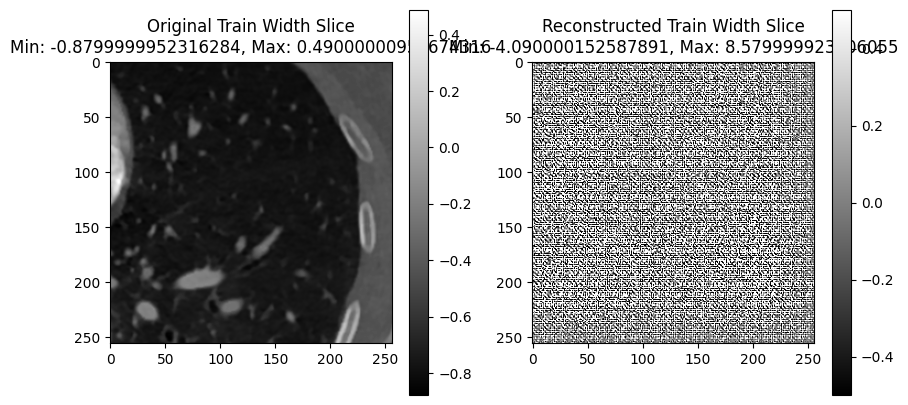

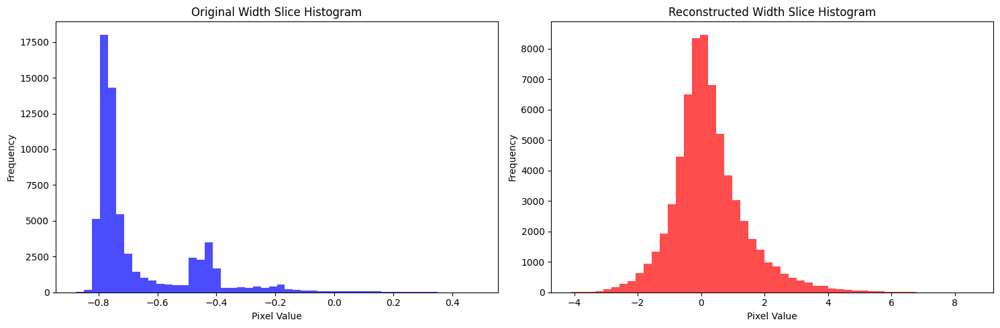

Validation: |          | 0/? [00:00<?, ?it/s]

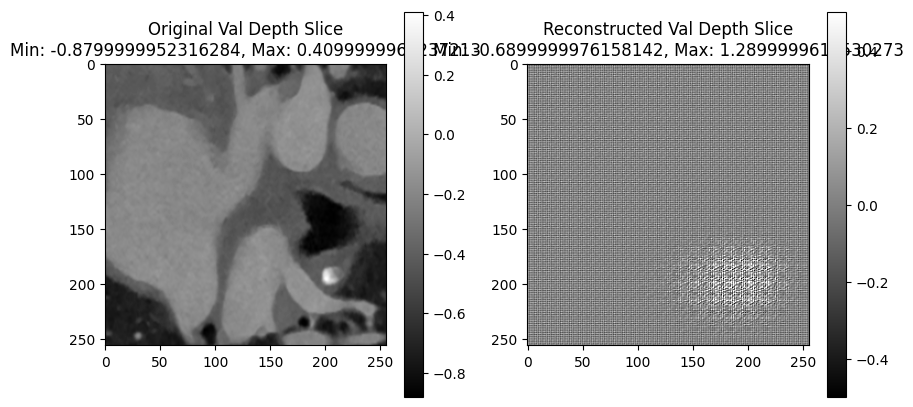

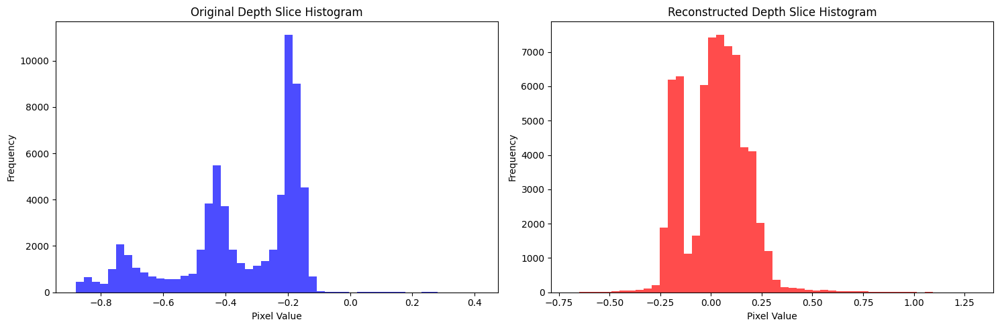

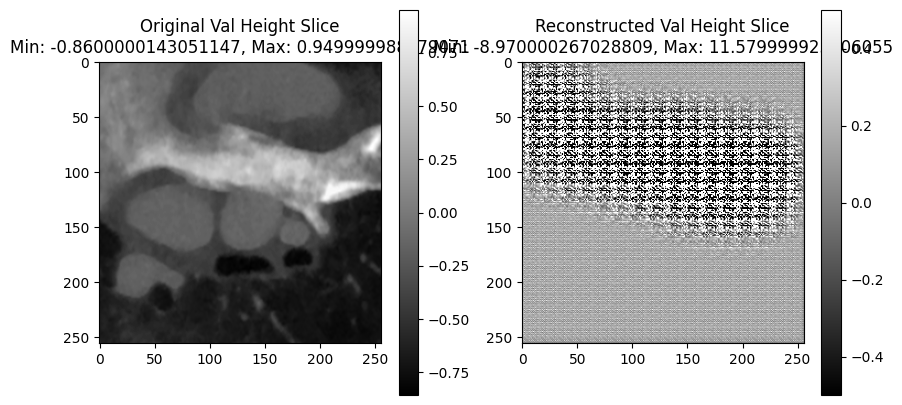

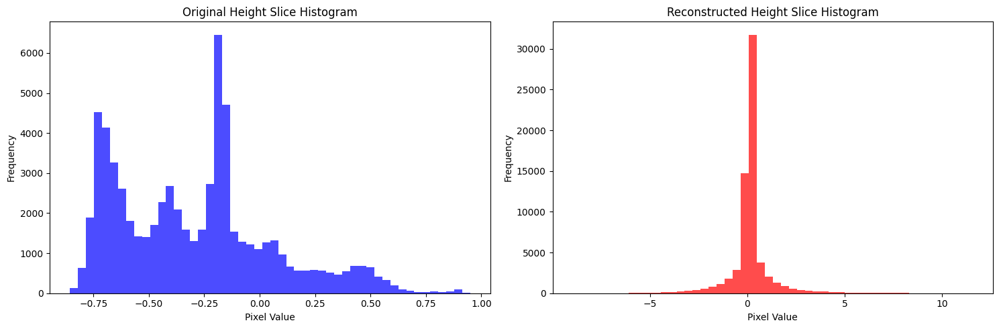

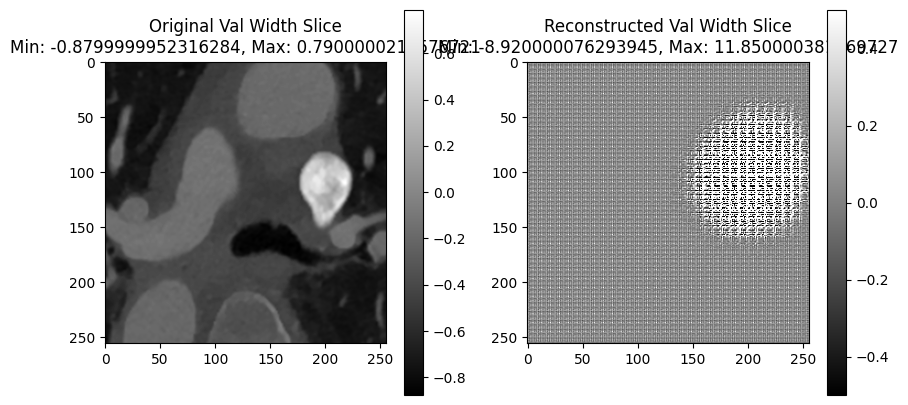

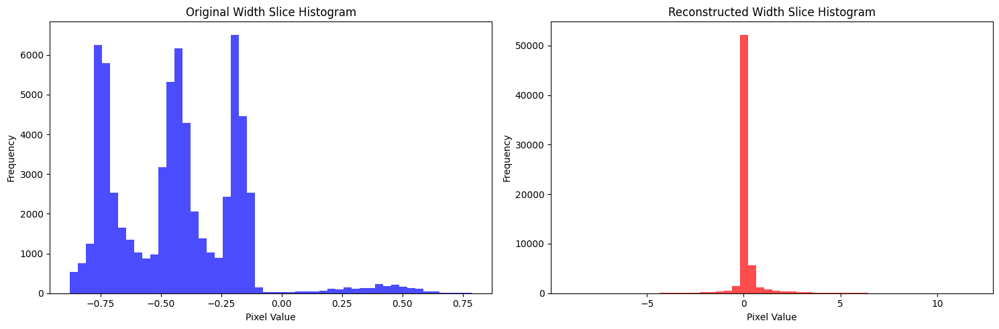

Time Spent 226.28
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 238.75
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 251.17
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 263.51
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 275.81
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 288.22
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 300.53
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 312.84
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 325.27
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 337.68
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 350.08
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 362.62
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 375.07
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 387.54
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 399.87
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 412.17
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 424.73
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 436.99
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 449.43
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 461.85
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 474.22
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 486.65
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 499.00
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 511.41
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 523.79
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 536.08
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 548.38
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 560.86
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 573.32
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 585.80
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 598.17
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 610.54
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 622.91
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 635.38
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 647.98
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 660.31
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 672.90
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 685.35
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 697.83
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 710.23
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 722.60
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 735.00
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 747.43
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 759.83
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 772.58
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 784.86
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 797.52
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 809.96
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 822.36
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 834.87
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 847.18
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 859.50
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 871.83
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 884.16
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 896.50
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 908.85
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 921.18
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 933.58
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 946.07
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 958.46
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 971.03
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 983.42
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 995.74
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1008.22
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1020.54
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1032.97
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1045.31
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1057.60
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1069.91
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1082.32
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1094.58
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1106.84
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1119.22
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1131.54
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1143.91
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1156.34
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1168.74
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1181.08
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1193.42
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1205.88
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1218.21
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1230.48
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1242.75
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1255.16
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1267.43
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1279.70
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1292.05
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1304.35
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1316.67
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1329.01
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1341.45
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1353.78
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1366.24
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1378.58
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1391.16
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1403.53
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1415.81
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1428.16
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1440.55
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1452.95
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1465.30
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1477.59
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1490.11
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1502.58
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1514.92
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1527.28
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1539.78
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1552.08
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1564.49
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1576.90
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1589.31
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1601.81
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1614.20
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1626.67
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1638.96
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1651.44
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1663.84
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1676.18
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1688.48
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1701.05
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1713.39
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1725.66
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1738.01
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1750.39
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1762.73
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1775.00
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1787.35
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1799.67
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1812.01
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1824.33
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1837.18
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1849.56
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1861.91
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1874.34
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1886.77
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1899.04
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1911.46
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1923.73
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1936.12
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1948.43
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1960.77
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1973.20
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1985.64
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1997.92
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2010.38
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2022.72
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2035.03
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2047.72
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2060.00
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2072.51
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2084.82
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2097.13
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2109.47
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2121.89
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2134.27
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2146.61
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2158.93
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2171.36
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2183.85
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2196.22
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2208.61
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2221.10
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2233.98
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2246.73
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2259.18
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2271.57
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2284.03
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2296.45
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2308.77
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2321.29
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2333.70
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2346.12
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2358.47
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2371.05
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2383.74
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2396.28
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2408.72
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2421.21
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2433.55
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2446.01
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2458.50
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2470.96
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2483.32
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2495.81
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2508.12
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2520.45
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2532.84
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2545.29
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2557.91
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2570.22
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2582.76
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2595.15
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2607.61
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2619.91
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2632.29
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2644.67
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2656.96
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2669.33
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2681.66
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2694.35
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2707.58
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2720.06
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2732.55
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2744.81
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2757.10
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2769.52
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2781.89
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2794.25
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2806.59
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2819.40
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2831.75
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2844.30
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2856.75
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2869.44
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2881.79
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2894.19
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2906.62
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2918.97
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2931.29
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2943.87
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2956.20
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2968.63
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2980.99
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2993.28
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3005.73
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3018.07
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3030.38
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3042.97
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3059.83
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3072.11
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3084.76
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3097.08
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3109.47
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3121.98
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3134.62
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3146.95
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3159.31
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3171.64
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3183.99
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3196.29
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3208.63
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3220.95
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3233.21
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3245.61
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3257.93
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3270.25
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3282.68
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3295.16
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3307.51
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3319.85
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3332.24
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3344.70
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3357.10
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3369.55
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3381.93
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3394.29
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3406.59
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3418.90
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3431.22
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3443.51
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3455.91
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3468.29
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3480.63
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3492.97
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3505.26
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3517.64
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3532.29
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3544.65
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3556.93
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3569.24
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3581.55
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3593.87
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3606.20
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3618.59
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3631.04
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3643.92
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3656.34
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3668.68
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3680.96
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3693.21
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3705.69
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3718.00
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3730.35
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3742.76
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3755.24
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3767.51
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3779.90
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3792.14
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3804.50
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3816.87
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3829.19
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3841.81
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3854.11
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3866.45
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3878.99
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3891.34
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3903.86
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3916.38
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3928.77
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3941.43
Epoch: 300


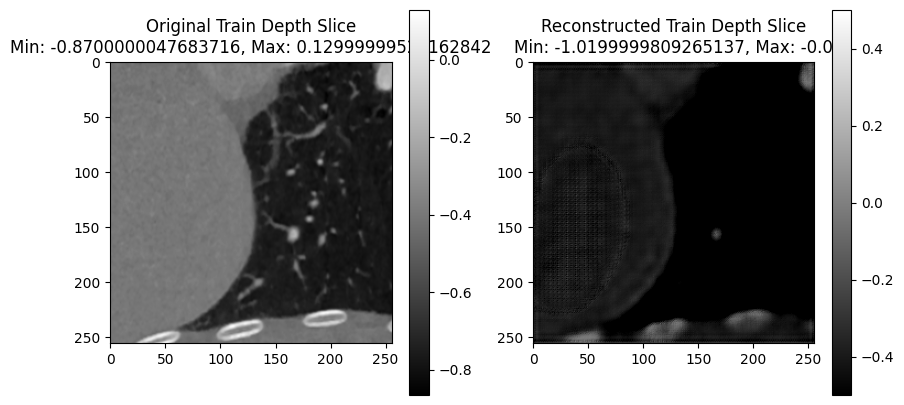

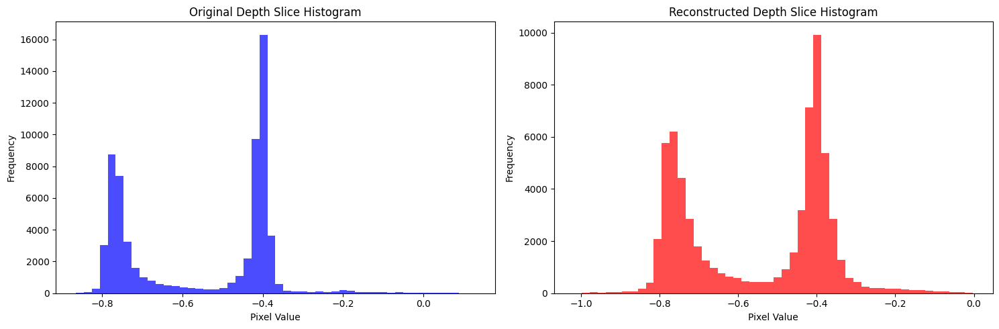

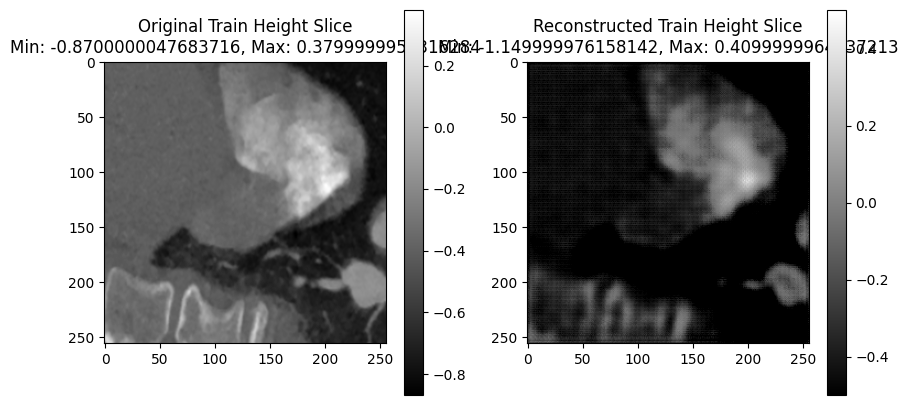

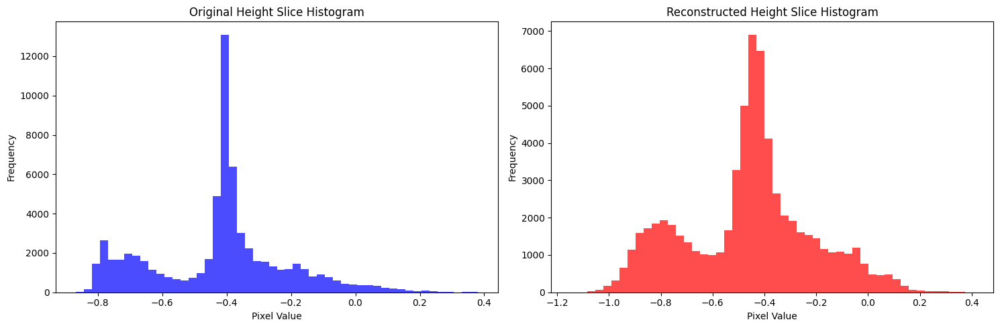

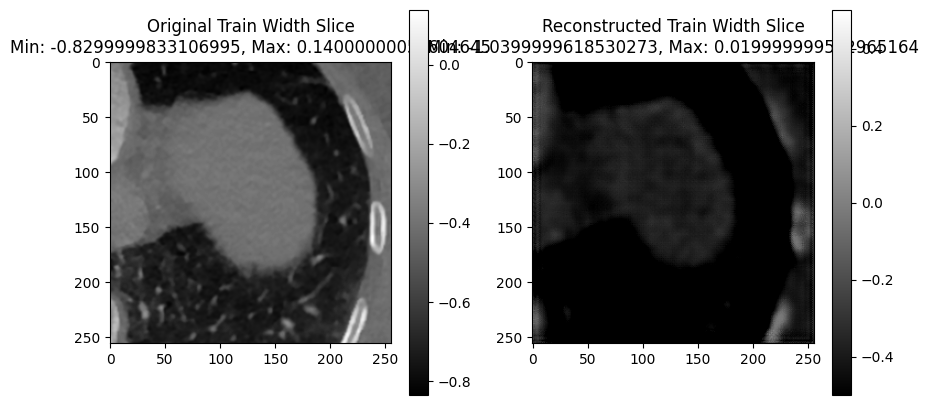

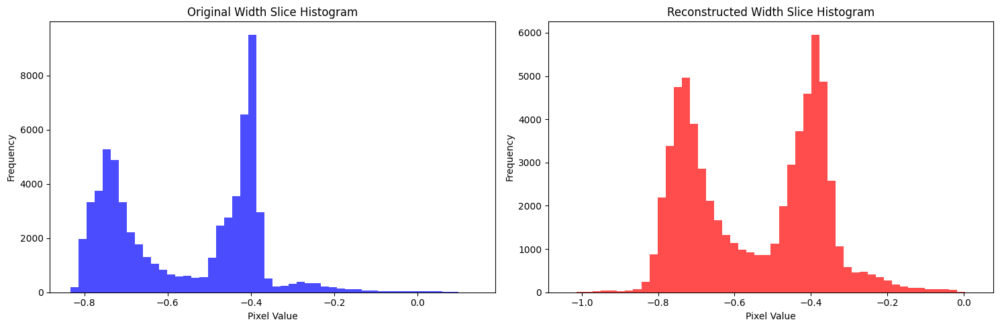

Validation: |          | 0/? [00:00<?, ?it/s]

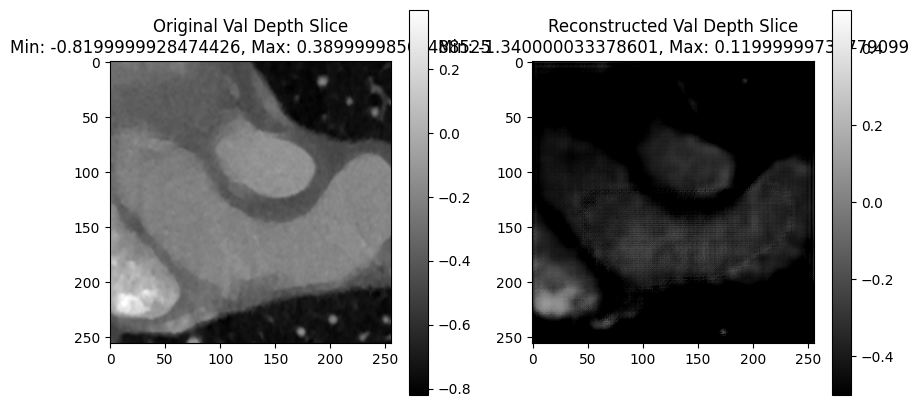

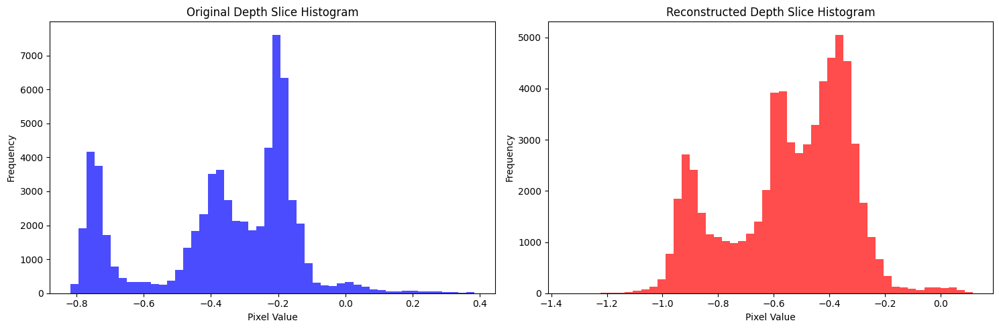

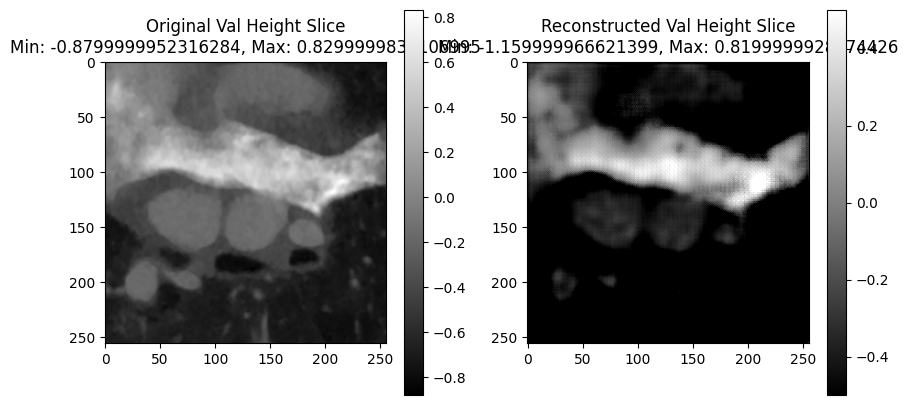

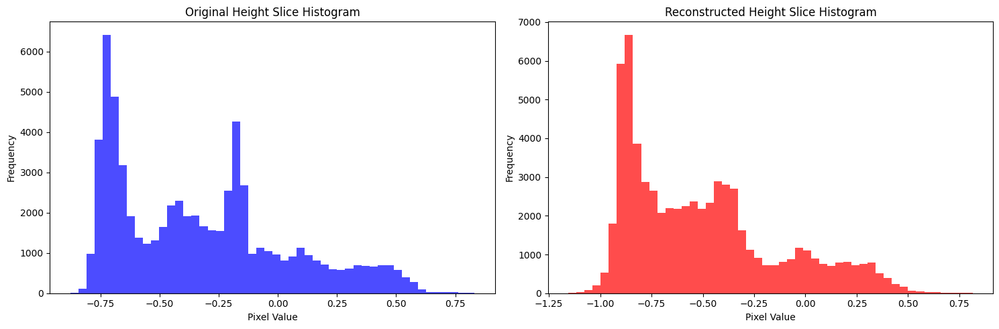

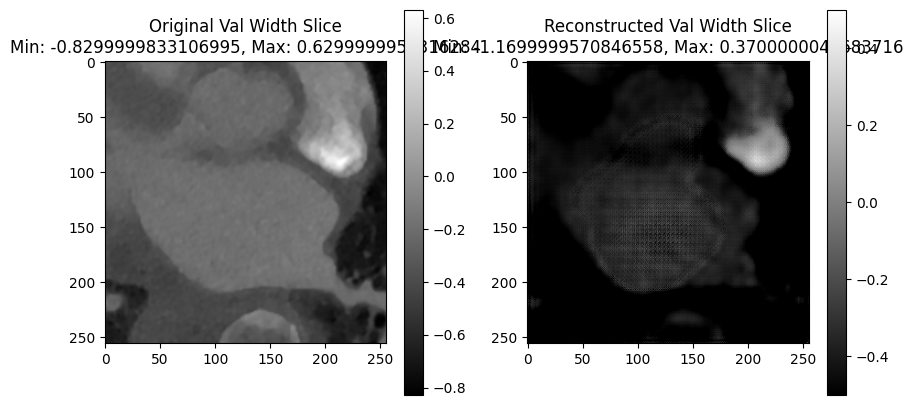

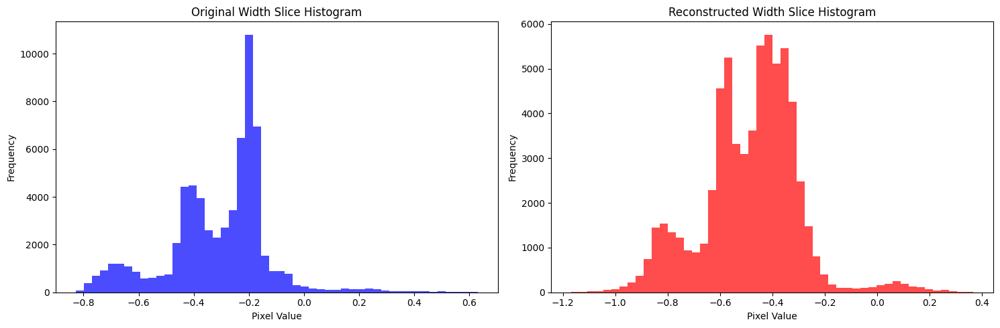

Time Spent 3959.99
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3972.32
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3984.76
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3997.07
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4009.42
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4022.00
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4034.55
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4047.18
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4059.66
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4071.94
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4084.40
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4096.94
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4109.41
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4121.88
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4134.28
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4146.72
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4159.15
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4171.62
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4184.07
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4196.77
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4209.20
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4221.95
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4234.40
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4246.79
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4259.20
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4271.69
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4284.34
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4296.89
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4309.38
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4321.85
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4334.35
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4346.75
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4359.17
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4371.89
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4384.22
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4396.66
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4409.21
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4421.65
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4434.11
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4446.52
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4458.86
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4471.39
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4483.89
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4496.21
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4509.22
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4521.70
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4534.04
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4546.44
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4558.72
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4571.11
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4583.38
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4595.63
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4608.00
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4620.28
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4632.56
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4644.92
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4657.32
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4669.92
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4682.37
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4694.66
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4707.06
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4719.49
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4731.91
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4744.36
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4756.69
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4768.94
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4781.44
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4793.93
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4806.22
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4818.68
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4831.00
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4843.28
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4855.62
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4867.89
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4880.46
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4892.81
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4905.08
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4917.62
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4930.09
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4942.44
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4954.92
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4967.23
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4979.64
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4992.13
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5004.43
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5016.87
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5029.22
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5041.49
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5053.86
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5066.19
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5078.44
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5090.79
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5103.22
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5115.58
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5127.93
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5140.31
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5152.75
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5165.43
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5177.90
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5190.36
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5204.01
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5216.36
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5231.20
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5243.64
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5256.01
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5268.45
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5280.79
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5293.21
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5305.59
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5318.13
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5330.77
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5343.42
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5355.80
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5368.22
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5380.59
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5392.93
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5405.35
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5417.82
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5430.28
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5442.70
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5455.02
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5467.35
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5479.74
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5492.13
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5504.60
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5516.91
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5529.28
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5541.65
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5553.97
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5566.31
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5578.63
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5590.89
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5603.45
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5615.85
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5628.19
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5640.53
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5652.86
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5665.12
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5677.65
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5689.96
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5702.21
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5714.68
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5726.97
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5739.27
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5751.72
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5764.03
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5776.51
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5789.05
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5801.36
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5813.94
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5826.34
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5838.72
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5851.09
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5863.41
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5875.65
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5888.01
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5900.48
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5913.08
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5925.44
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5937.77
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5950.09
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5962.68
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5975.08
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5987.49
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5999.87
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6012.22
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6024.98
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6037.41
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6049.77
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6062.24
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6074.80
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6087.32
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6099.90
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6112.16
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6124.63
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6136.90
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6149.36
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6161.74
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6174.24
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6186.52
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6199.21
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6211.51
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6223.79
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6236.17
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6248.58
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6260.87
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6273.29
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6285.59
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6297.93
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6310.26
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6322.59
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6334.91
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6347.19
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6359.59
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6372.00
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6384.35
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6396.65
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6409.11
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6421.53
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6433.86
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6446.24
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6458.55
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6470.88
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6483.39
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6495.72
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6508.14
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6520.39
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6532.69
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6545.23
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6557.62
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6569.93
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6582.40
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6594.91
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6607.32
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6619.86
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6632.14
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6644.51
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6656.77
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6669.26
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6681.63
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6694.01
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6706.27
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6718.70
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6731.02
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6743.50
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6755.82
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6768.16
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6780.60
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6792.91
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6805.24
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6817.65
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6829.93
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6842.24
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6854.74
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6867.05
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6879.42
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6891.79
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6904.08
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6916.39
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6928.88
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6941.71
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6954.19
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6966.59
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6978.88
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6991.20
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7003.64
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7015.95
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7028.37
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7040.72
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7053.19
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7065.46
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7077.93
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7090.29
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7102.62
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7114.99
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7127.44
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7140.22
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7153.22
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7167.25
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7179.55
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7192.05
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7204.56
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7216.85
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7229.27
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7243.10
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7255.42
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7267.78
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7280.43
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7292.82
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7305.39
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7317.80
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7330.55
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7343.39
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7356.58
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7369.07
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7381.54
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7393.80
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7406.44
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7418.89
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7431.24
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7443.74
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7456.03
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7469.42
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7482.03
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7494.41
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7506.97
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7519.59
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7531.94
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7544.76
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7557.01
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7569.33
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7581.99
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7594.40
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7606.86
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7619.31
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7631.72
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7647.42
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7659.97
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7672.34
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7684.69
Epoch: 600


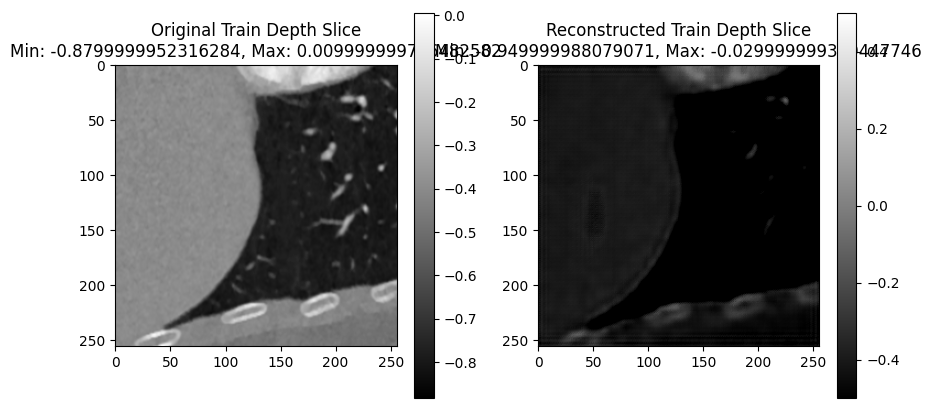

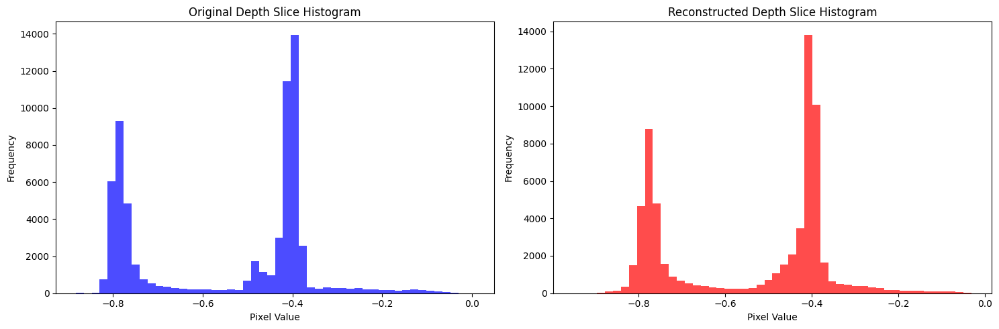

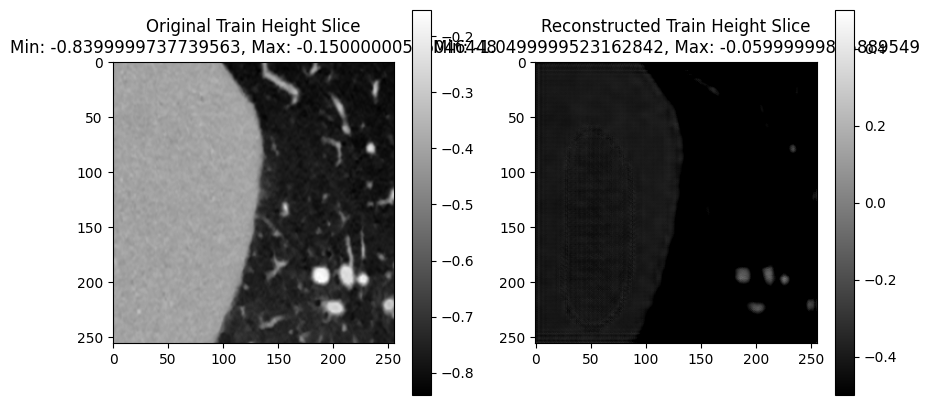

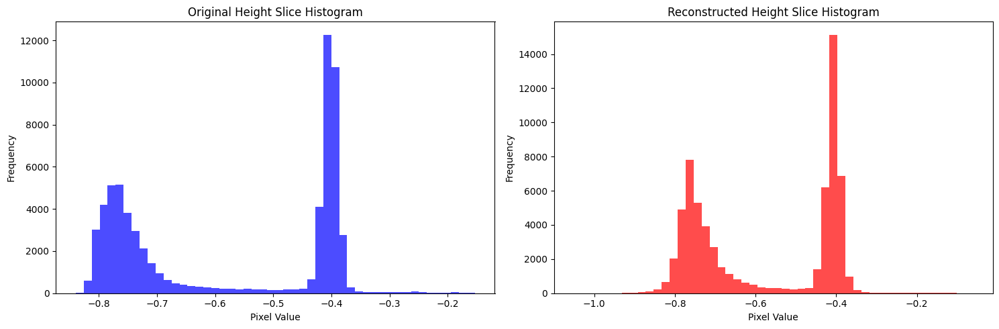

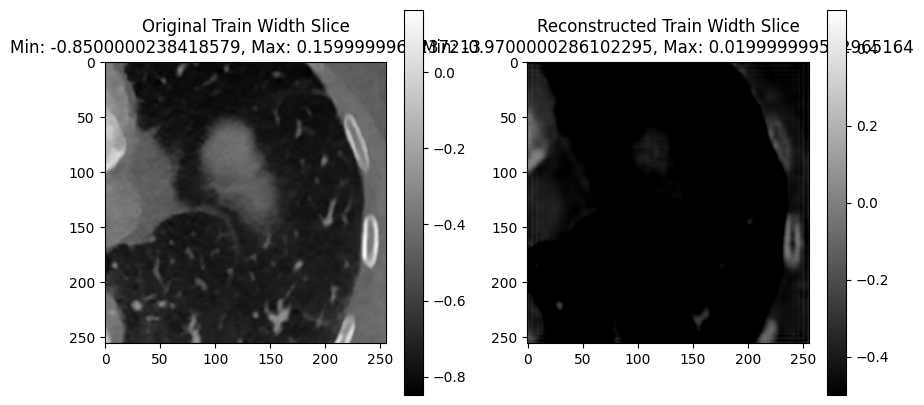

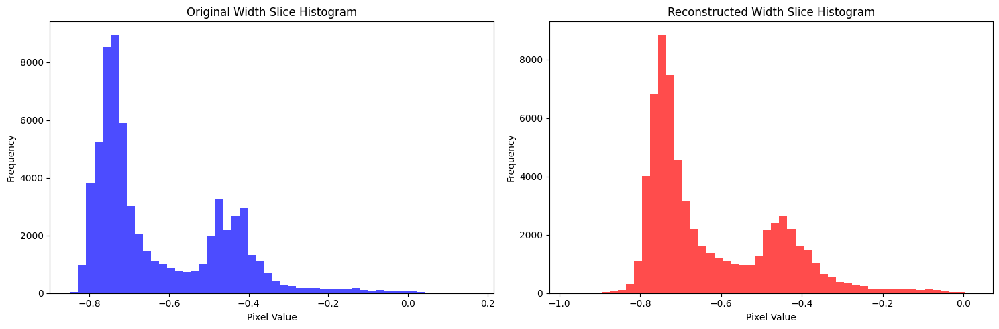

Validation: |          | 0/? [00:00<?, ?it/s]

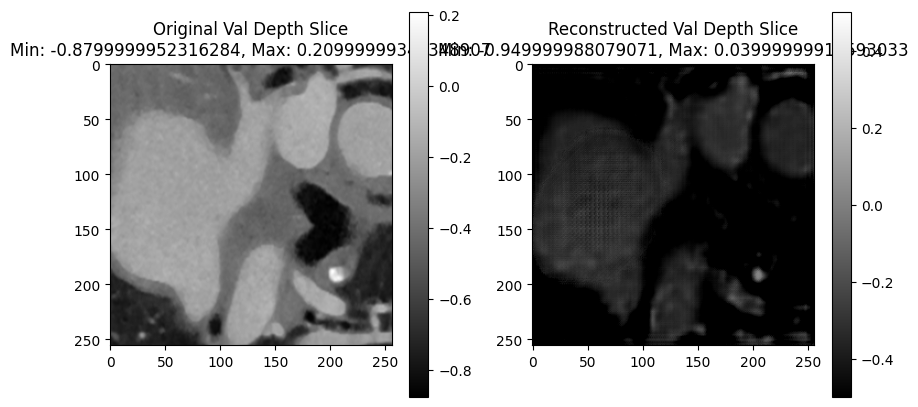

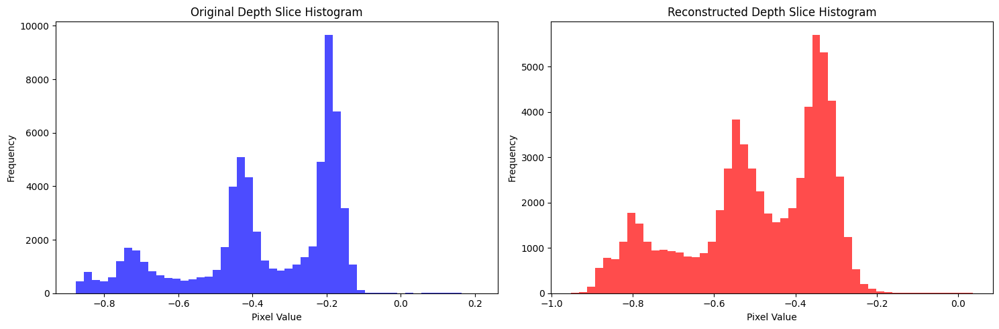

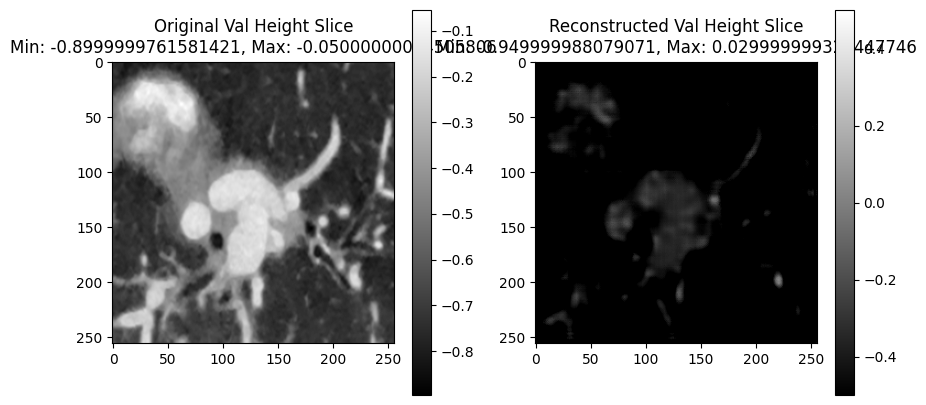

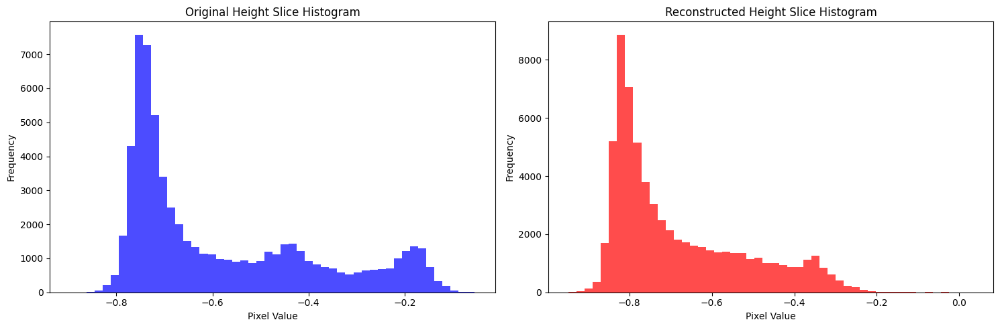

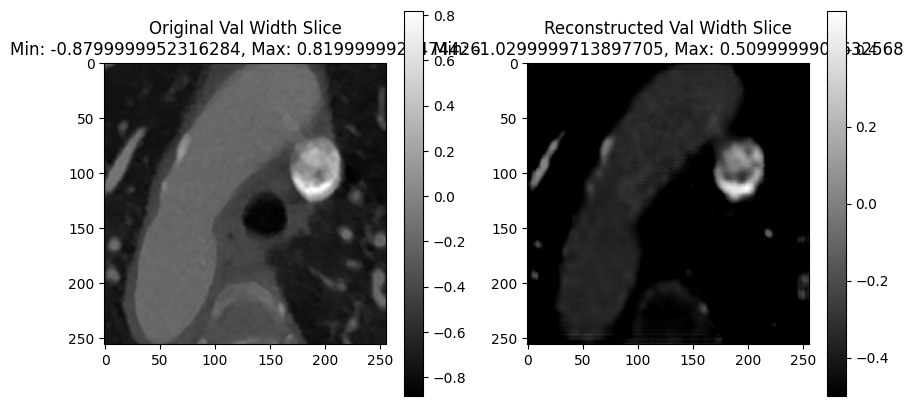

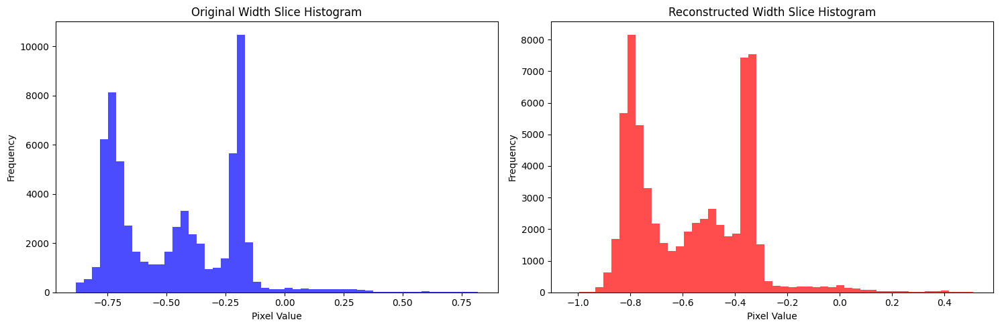

Time Spent 7704.62
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7720.12
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7732.52
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7748.59
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7764.42
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7779.48
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7791.77
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7804.05
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7816.45
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7828.92
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7841.17
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7853.61
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7866.19
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7878.53
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7890.88
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7903.26
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7915.92
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7928.30
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7940.61
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7952.97
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7965.26
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7977.60
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7990.01
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8002.46
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8014.88
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8027.13
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8039.46
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8051.84
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8064.10
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8076.47
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8088.85
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8101.16
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8113.46
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8125.85
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8138.15
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8150.45
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8162.78
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8175.14
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8187.58
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8199.96
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8212.48
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8225.14
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8237.98
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8251.11
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8263.74
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8276.90
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8289.56
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8302.07
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8314.41
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8326.86
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8339.09
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8351.58
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8363.95
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8376.56
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8389.18
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8401.77
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8414.05
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8426.43
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8438.83
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8451.19
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8463.71
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8476.21
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8488.69
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8501.00
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8513.36
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8525.69
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8538.20
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8550.48
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8562.81
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8575.28
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8587.68
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8599.98
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8612.39
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8624.73
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8637.14
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8649.41
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8661.77
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8674.18
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8686.57
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8698.88
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8711.46
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8723.75
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8736.05
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8748.44
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8761.00
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8773.47
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8785.87
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8798.36
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8810.71
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8823.01
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8835.48
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8847.86
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8860.23
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8872.71
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8885.07
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8897.42
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8909.77
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8922.15
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8934.40
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8946.79
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8959.08
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8971.38
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8983.86
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8996.18
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9008.54
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9021.13
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9033.46
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9045.79
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9058.14
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9070.41
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9082.94
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9095.74
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9108.04
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9120.38
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9132.67
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9145.42
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9157.75
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9170.03
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9182.41
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9194.72
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9207.03
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9219.34
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9231.70
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9244.07
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9256.57
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9268.85
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9281.21
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9293.63
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9305.97
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9318.31
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9330.65
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9343.00
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9355.29
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9367.67
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9380.14
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9392.54
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9405.15
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9417.67
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9429.98
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9442.31
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9454.70
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9467.17
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9479.57
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9492.07
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9504.50
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9517.00
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9529.34
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9541.81
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9554.22
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9566.59
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9578.92
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9591.24
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9603.66
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9616.03
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9628.38
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9640.85
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9653.19
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9665.51
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9677.89
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9690.22
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9702.51
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9714.89
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9727.24
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9739.57
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9752.25
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9764.54
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9776.87
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9789.36
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9801.65
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9814.01
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9826.34
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9838.69
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9851.10
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9863.42
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9875.82
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9888.15
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9900.41
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9912.79
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9925.12
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9937.47
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9949.83
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9962.22
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9974.57
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9986.92
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9999.29
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10011.84
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10024.41
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10036.67
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10049.04
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10061.31
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10073.58
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10086.10
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10098.46
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10110.84
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10123.18
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10135.47
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10147.91
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10160.35
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10172.78
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10185.24
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10198.61
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10211.06
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10223.51
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10235.81
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10248.22
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10260.64
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10272.86
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10285.17
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10297.55
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10309.85
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10322.29
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10334.77
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10347.10
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10359.55
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10372.31
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10384.62
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10396.98
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10409.25
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10421.54
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10433.84
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10446.15
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10458.48
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10470.83
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10483.14
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10495.46
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10507.73
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10520.22
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10532.69
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10545.05
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10557.34
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10569.78
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10582.27
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10594.80
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10607.24
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10619.57
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10631.98
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10644.35
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10656.61
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10668.96
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10681.25
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10693.54
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10705.93
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10718.32
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10731.24
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10743.70
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10756.05
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10768.48
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10780.78
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10793.05
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10805.46
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10817.82
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10830.11
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10842.50
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10854.89
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10867.30
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10879.89
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10892.15
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10904.41
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10916.75
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10929.12
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10941.40
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10953.78
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10966.08
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10978.39
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10990.68
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11002.96
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11015.40
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11027.65
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11040.00
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11052.40
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11064.75
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11077.03
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11089.41
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11101.69
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11114.05
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11126.38
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11138.68
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11151.85
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11164.13
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11176.60
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11188.97
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11201.28
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11213.56
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11225.94
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11238.29
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11250.70
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11263.18
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11275.49
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11287.86
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11300.20
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11312.76
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11325.25
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11337.52
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11349.91
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11362.49
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11374.88
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11387.28
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11399.97
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11412.39
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11424.76
Epoch: 900


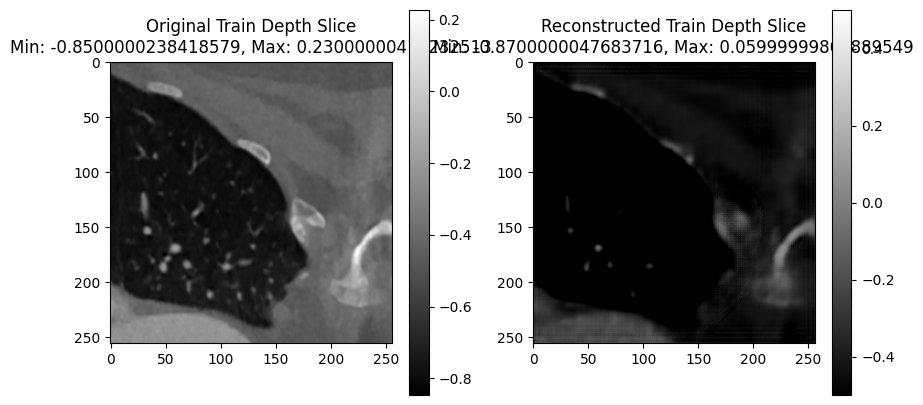

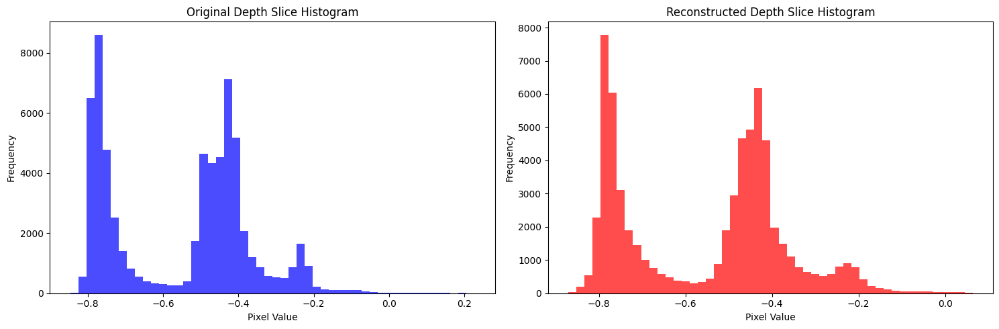

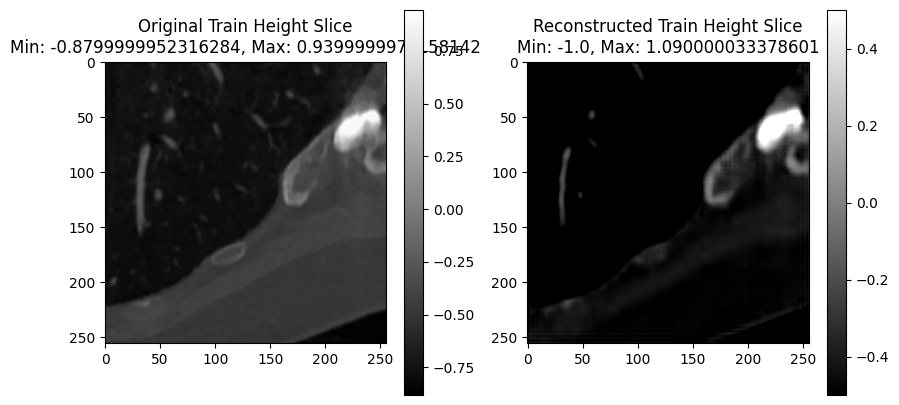

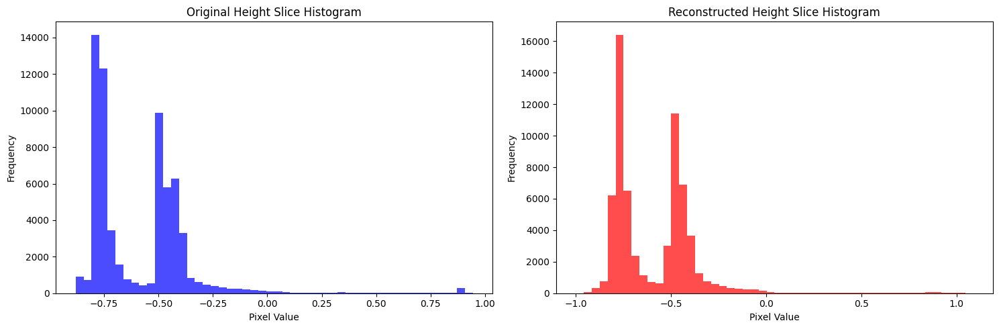

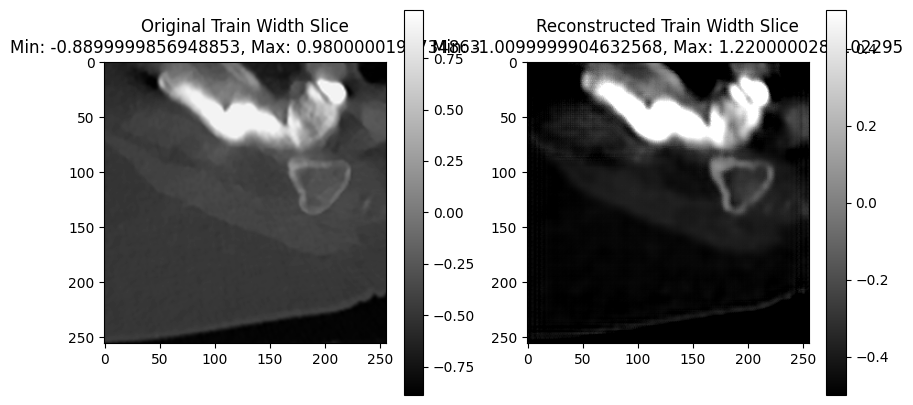

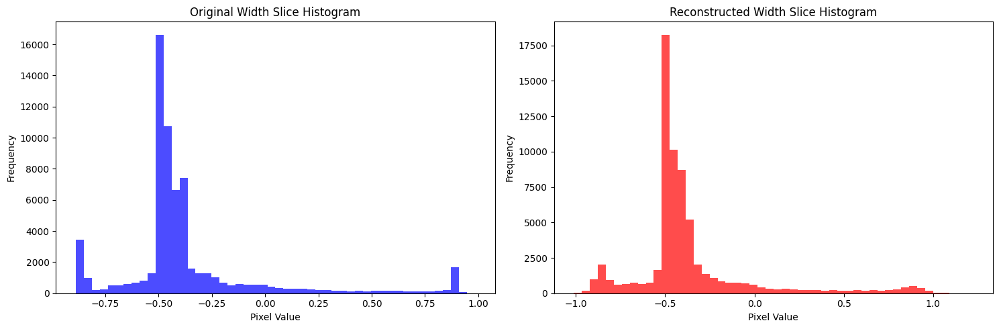

Validation: |          | 0/? [00:00<?, ?it/s]

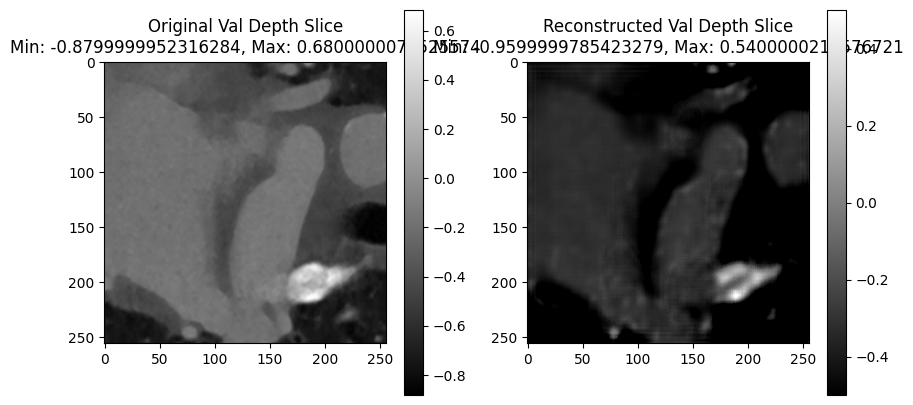

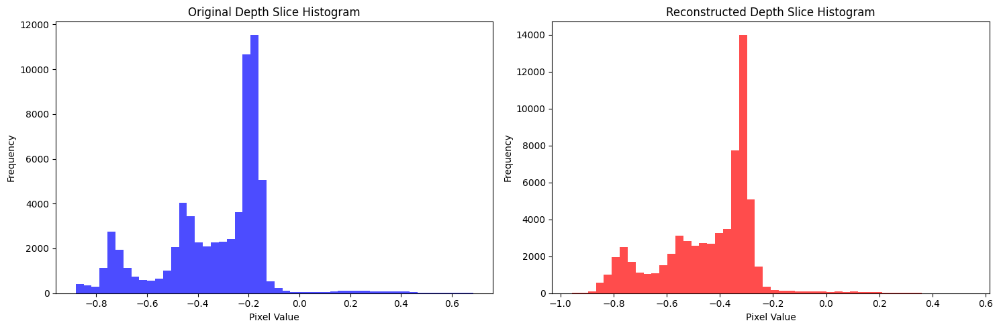

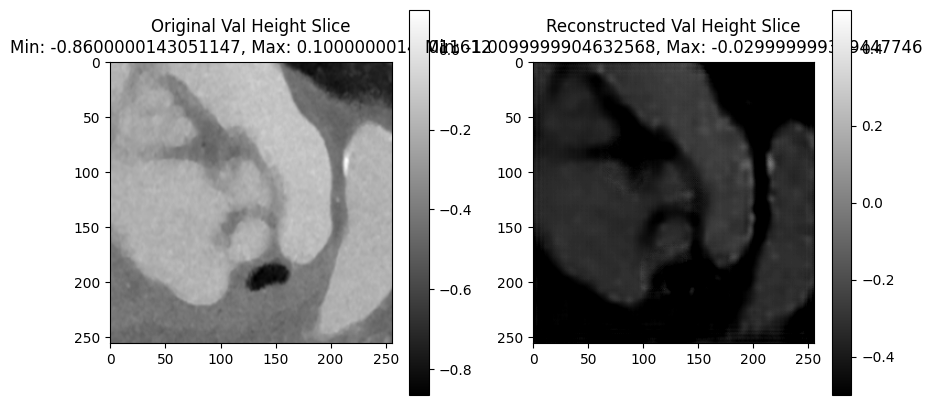

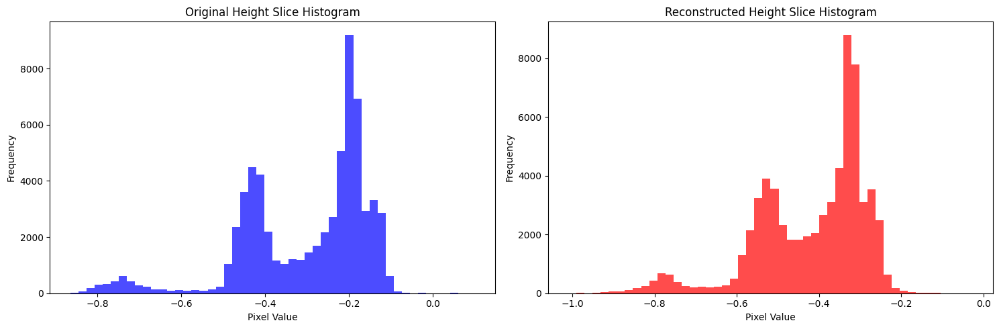

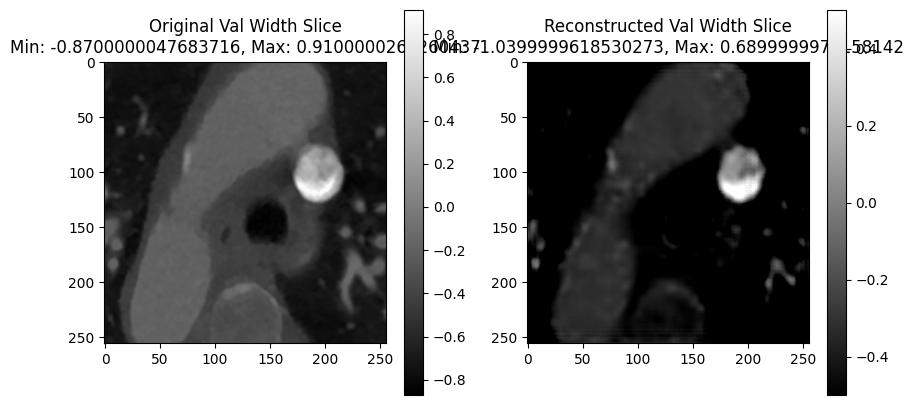

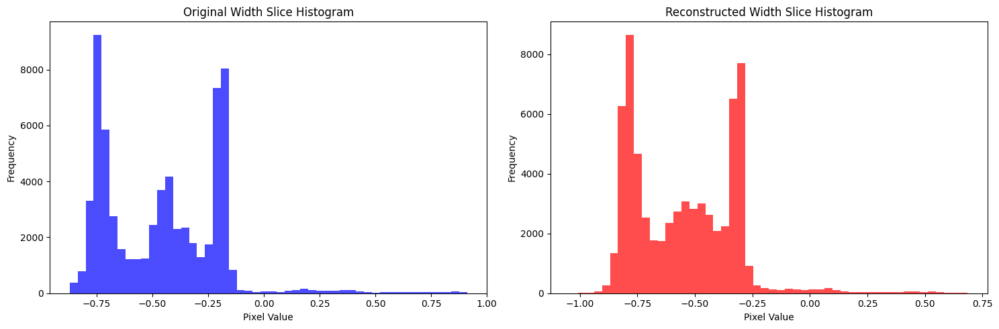

Time Spent 11443.73
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11456.02
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11468.47
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11480.83
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11493.12
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11505.64
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11518.09
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11530.36
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11542.86
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11555.48
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11567.92
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11580.57
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11593.09
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11605.52
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11617.88
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11630.18
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11642.80
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11655.08
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11667.56
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11680.02
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11692.38
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11705.11
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11717.62
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11729.98
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11742.36
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11754.65
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11766.94
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11779.48
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11791.89
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11804.17
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11816.71
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11829.02
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11841.38
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11853.71
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11866.15
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11878.48
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11890.97
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11903.46
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11915.90
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11928.22
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11940.60
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11953.08
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11965.50
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11977.98
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11990.38
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12002.75
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12015.05
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12027.55
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12040.00
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12052.46
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12064.83
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12077.12
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12089.53
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12101.90
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12114.39
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12126.80
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12139.09
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12151.40
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12163.97
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12176.39
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12188.76
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12201.13
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12213.48
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12226.27
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12238.73
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12251.14
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12263.55
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12275.85
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12288.36
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12300.73
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12313.14
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12325.47
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12337.97
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12350.35
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12362.79
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12375.14
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12387.84
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12400.32
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12412.68
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12425.21
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12437.68
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12450.05
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12462.43
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12474.99
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12487.33
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12499.73
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12512.12
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12524.60
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12537.00
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12549.32
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12561.69
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12574.06
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12586.37
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12598.70
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12611.09
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12623.53
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12635.81
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12648.19
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12660.56
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12672.89
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12686.14
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12698.55
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12711.09
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12723.40
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12735.73
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12748.09
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12760.39
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12772.73
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12785.19
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12797.51
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12809.84
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12822.25
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12834.66
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12847.11
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12859.46
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12871.88
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12884.30
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12896.66
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12908.99
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12921.49
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12933.84
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12946.12
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12958.52
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12970.78
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12983.20
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12995.52
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13007.94
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13020.38
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13032.66
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13045.03
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13057.56
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13069.84
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13082.29
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13094.74
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13107.12
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13119.56
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13132.07
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13144.46
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13156.83
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13169.19
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13181.53
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13193.89
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13206.50
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13218.97
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13231.38
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13243.75
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13256.15
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13268.54
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13280.89
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13293.37
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13305.65
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13317.99
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13330.50
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13342.94
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13355.30
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13367.83
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13380.24
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13392.58
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13405.13
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13417.53
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13430.36
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13442.95
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13455.29
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13467.72
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13480.03
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13492.35
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13504.79
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13517.21
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13529.85
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13542.36
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13554.70
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13567.11
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13579.54
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13591.87
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13604.37
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13616.80
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13629.12
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13641.52
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13653.89
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13666.18
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13678.72
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13691.03
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13703.36
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13715.73
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13728.16
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13740.52
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13752.93
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13765.26
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13777.70
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13790.11
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13802.47
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13814.92
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13827.28
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13839.82
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13852.18
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13864.48
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13876.92
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13890.12
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13902.46
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13914.91
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13927.41
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13939.91
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13952.28
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13964.63
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13976.89
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13989.38
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14001.81
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14014.25
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14026.93
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14039.25
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14051.55
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14064.04
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14076.32
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14088.70
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14101.02
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14113.36
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14125.91
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14138.22
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14150.51
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14162.98
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14175.30
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14187.64
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14200.02
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14212.34
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14224.78
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14237.05
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14249.39
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14261.81
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14274.11
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14286.40
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14298.91
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14311.25
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14323.53
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14340.51
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14352.97
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14365.39
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14377.93
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14390.23
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14402.59
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14414.98
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14427.29
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14439.67
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14452.04
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14464.40
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14476.79
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14489.04
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14501.33
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14513.72
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14526.02
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14538.35
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14550.76
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14563.07
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14575.45
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14587.91
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14600.29
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14612.80
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14625.08
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14637.41
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14649.85
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14662.15
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14674.46
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14686.93
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14699.28
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14711.69
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14724.04
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14736.56
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14749.13
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14761.52
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14773.86
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14786.24
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14798.59
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14811.01
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14823.41
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14835.75
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14848.31
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14860.71
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14873.23
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14885.60
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14897.91
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14910.21
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14922.58
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14934.95
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14947.36
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14959.80
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14972.28
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14984.70
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14997.14
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15009.54
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15022.40
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15034.85
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15047.16
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15059.71
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15072.19
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15084.63
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15097.07
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15109.51
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15121.92
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15134.33
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15146.71
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15159.24
Epoch: 1200


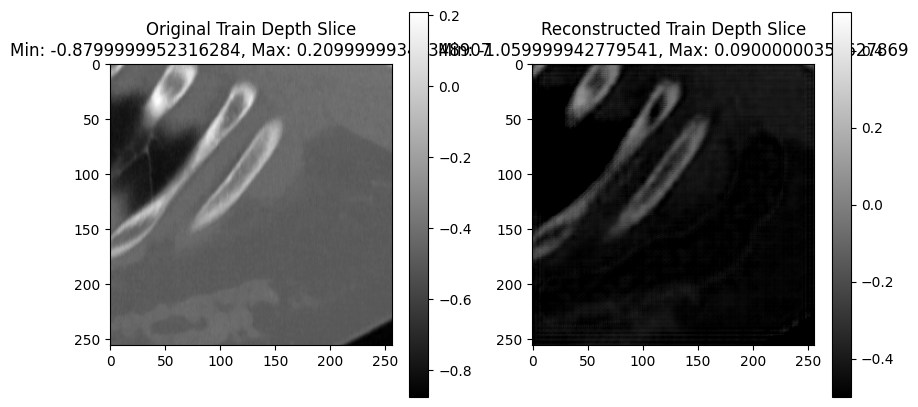

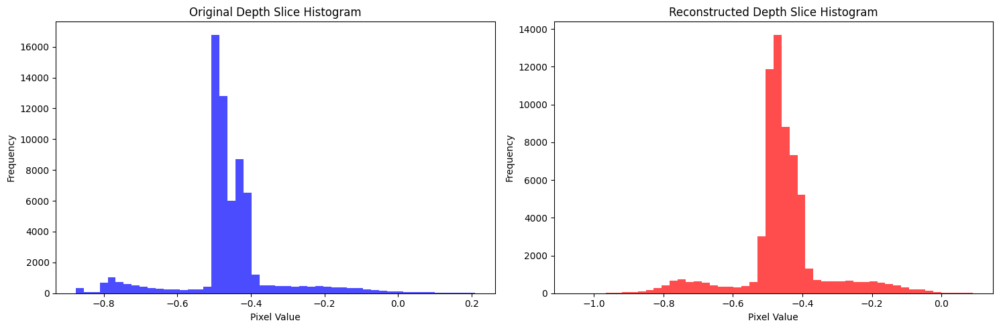

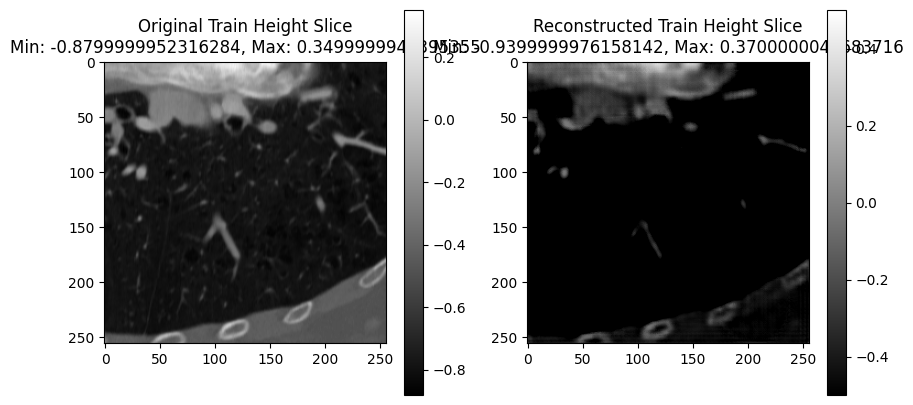

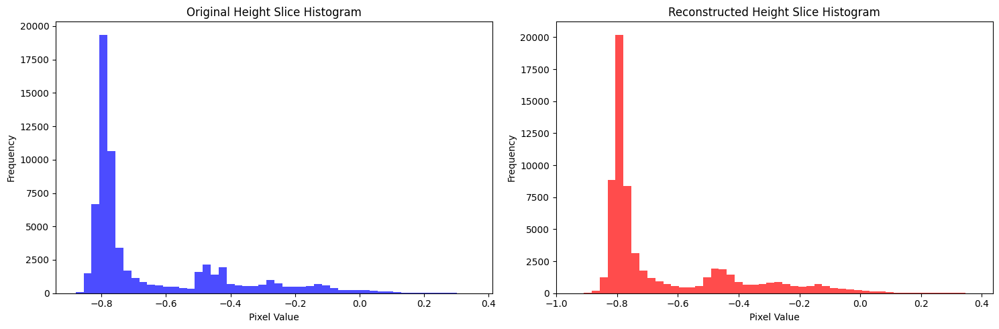

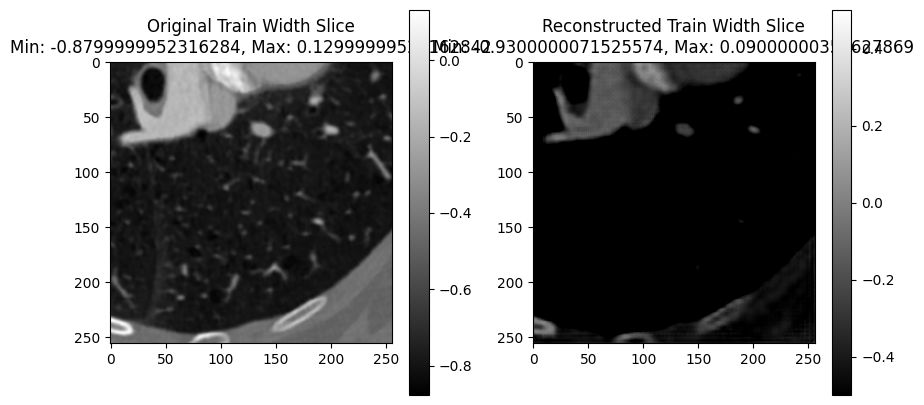

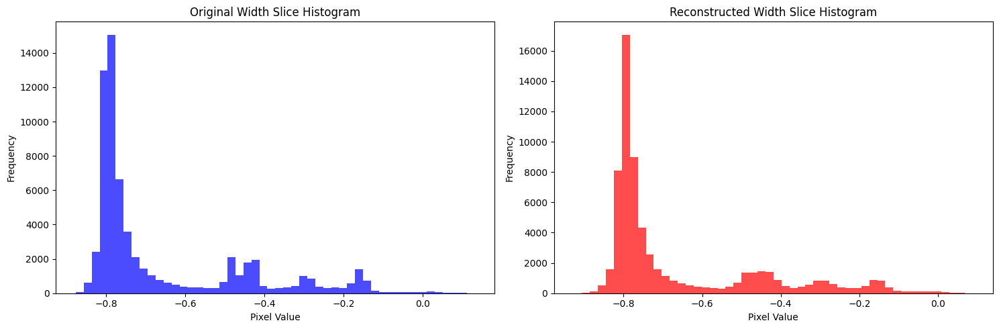

Validation: |          | 0/? [00:00<?, ?it/s]

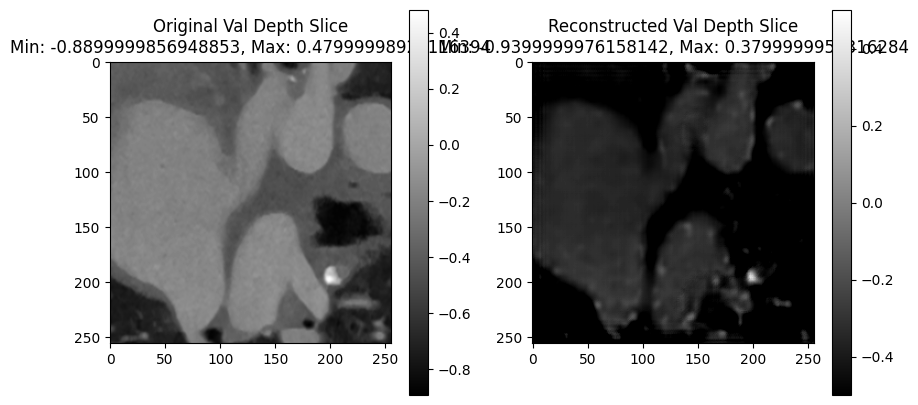

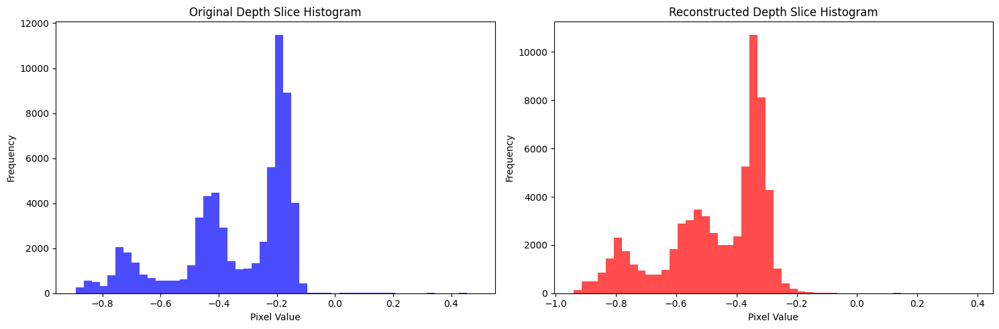

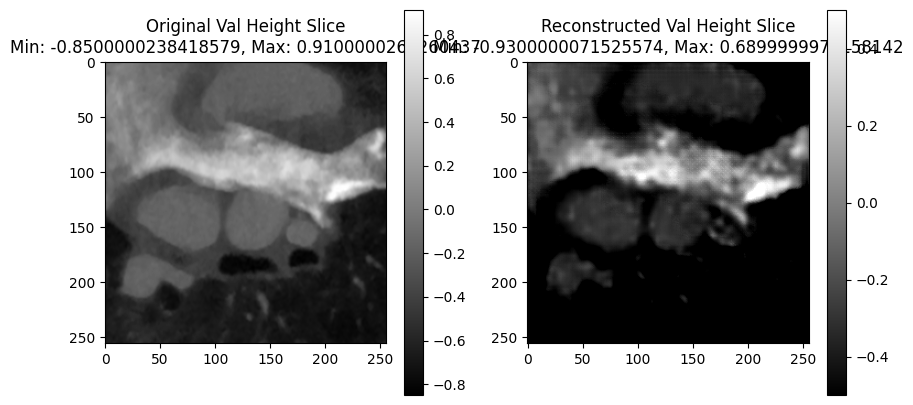

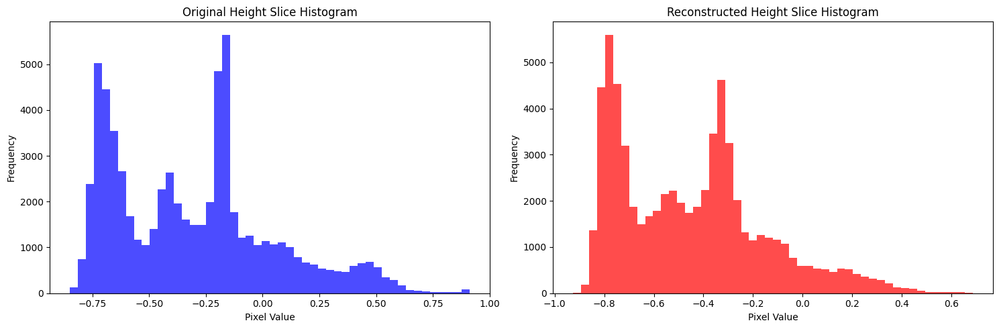

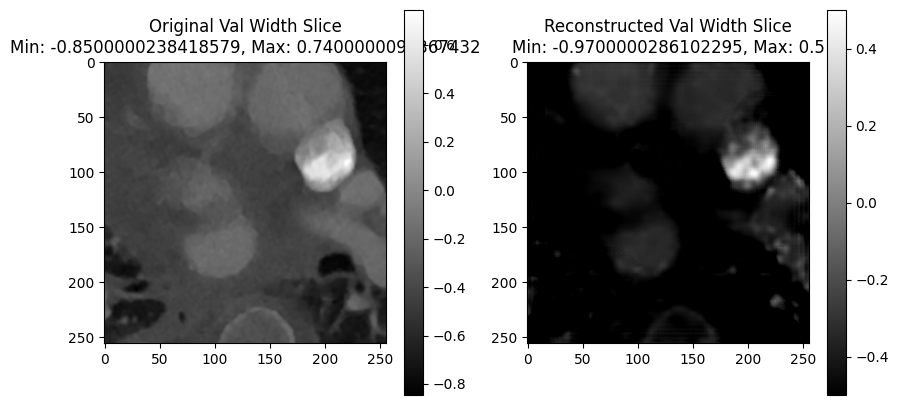

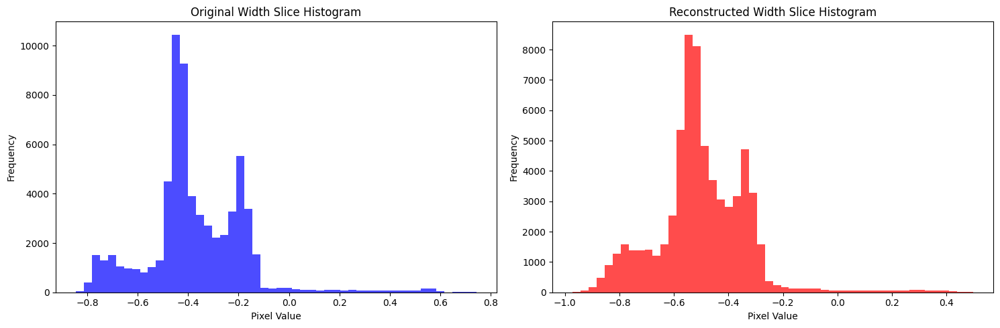

Time Spent 15179.55
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15191.88
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15204.36
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15216.74
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15229.02
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15241.41
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15253.68
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15266.03
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15278.44
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15290.87
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15303.23
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15315.86
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15328.16
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15340.55
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15352.92
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15365.21
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15377.56
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15389.94
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15402.42
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15414.80
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15427.11
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15439.70
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15452.04
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15464.39
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15476.85
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15489.33
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15502.02
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15514.43
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15526.68
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15539.11
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15551.55
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15564.19
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15576.51
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15589.03
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15601.34
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15613.63
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15626.05
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15638.51
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15651.02
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15663.48
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15675.79
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15688.14
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15700.51
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15712.76
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15725.38
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15737.77
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15750.06
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15762.55
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15774.96
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15787.83
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15800.32
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15812.61
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15825.06
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15837.39
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15849.89
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15862.24
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15874.54
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15886.98
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15899.37
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15912.07
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15924.39
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15936.74
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15949.06
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15961.44
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15973.80
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15986.31
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15998.78
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16011.11
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16023.47
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16035.82
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16048.18
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16060.57
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16072.93
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16085.43
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16097.77
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16110.37
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16122.69
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16135.07
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16147.56
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16159.87
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16172.21
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16184.48
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16196.76
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16209.06
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16221.46
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16233.81
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16246.21
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16258.51
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16270.85
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16283.16
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16295.45
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16307.94
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16320.22
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16332.63
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16344.96
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16357.27
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16369.54
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16381.91
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16394.17
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16406.55
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16418.79
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16431.07
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16443.46
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16455.87
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16468.15
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16480.59
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16492.92
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16505.35
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16517.68
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16529.96
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16542.31
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16554.87
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16567.17
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16579.74
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16592.00
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16604.36
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16616.78
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16629.08
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16641.43
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16653.86
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16666.28
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16678.60
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16690.94
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16703.25
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16715.77
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16728.41
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16740.71
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16753.36
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16765.72
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16778.07
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16790.66
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16803.24
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16815.58
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16828.14
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16840.42
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16852.73
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16865.07
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16877.39
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16889.91
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16902.24
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16914.59
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16927.00
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16939.33
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16951.76
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16964.10
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16976.53
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16988.90
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17001.33
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17013.67
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17026.05
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17038.33
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17050.65
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17063.08
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17075.38
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17087.65
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17100.04
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17112.35
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17124.74
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17137.13
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17149.40
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17161.68
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17174.07
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17186.39
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17198.75
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17211.05
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17223.31
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17235.78
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17248.08
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17260.46
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17272.96
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17285.27
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17297.74
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17310.23
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17322.55
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17334.90
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17347.32
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17359.86
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17372.24
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17384.58
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17396.87
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17409.31
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17421.61
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17433.89
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17446.22
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17458.49
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17470.82
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17483.20
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17495.54
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17507.90
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17520.19
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17532.48
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17544.94
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17557.26
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17569.55
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17582.05
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17594.39
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17606.66
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17619.08
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17631.56
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17643.90
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17657.10
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17669.40
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17682.00
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17694.42
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17706.85
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17719.24
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17731.64
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17744.01
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17756.40
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17768.75
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17781.06
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17793.49
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17805.81
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17818.21
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17830.56
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17842.85
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17855.30
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17867.60
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17879.89
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17892.24
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17904.62
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17917.00
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17929.90
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17942.32
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17954.70
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17967.00
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17979.34
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17991.78
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18004.32
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18016.56
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18028.99
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18041.24
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18053.60
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18065.99
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18078.29
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18090.56
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18102.96
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18115.47
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18127.85
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18140.20
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18152.50
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18164.85
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18177.20
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18189.63
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18202.20
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18214.53
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18226.86
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18239.39
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18251.68
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18264.25
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18276.56
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18288.84
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18301.20
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18313.60
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18325.97
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18338.44
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18350.74
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18363.03
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18375.55
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18387.86
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18400.22
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18412.61
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18424.94
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18437.44
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18449.81
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18462.08
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18474.64
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18487.03
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18499.39
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18511.86
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18524.21
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18536.52
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18548.97
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18561.26
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18573.61
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18585.92
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18598.40
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18610.93
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18623.28
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18635.87
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18648.44
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18660.93
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18673.33
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18685.80
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18698.14
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18710.51
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18722.95
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18735.32
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18747.79
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18760.16
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18772.91
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18785.26
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18797.56
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18810.07
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18822.62
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18835.01
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18847.32
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18859.81
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18872.24
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18884.63
Epoch: 1500


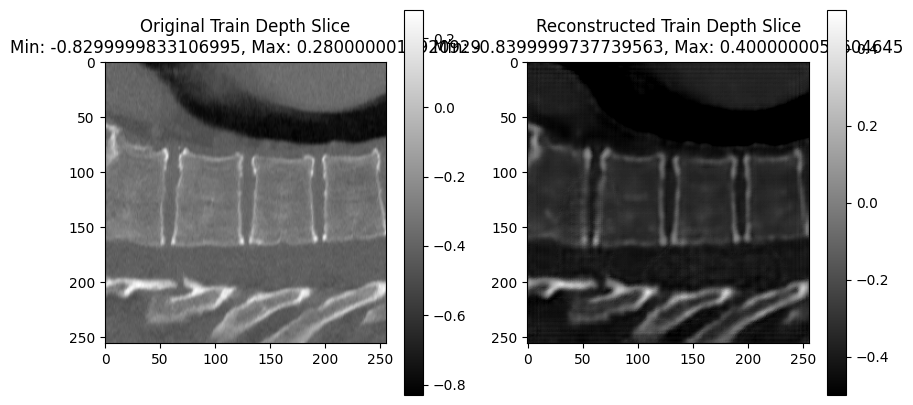

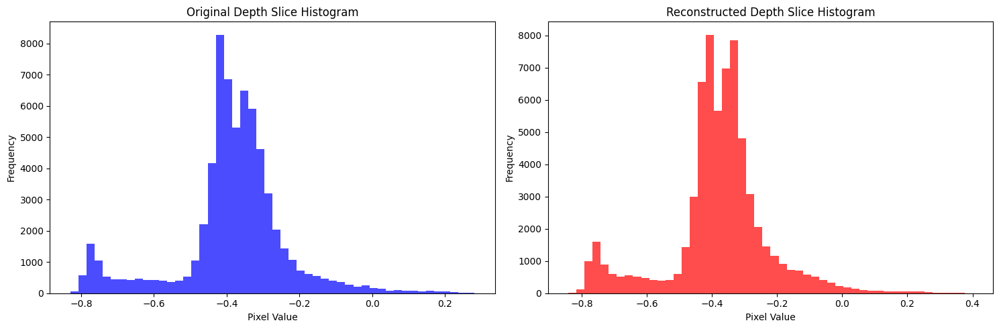

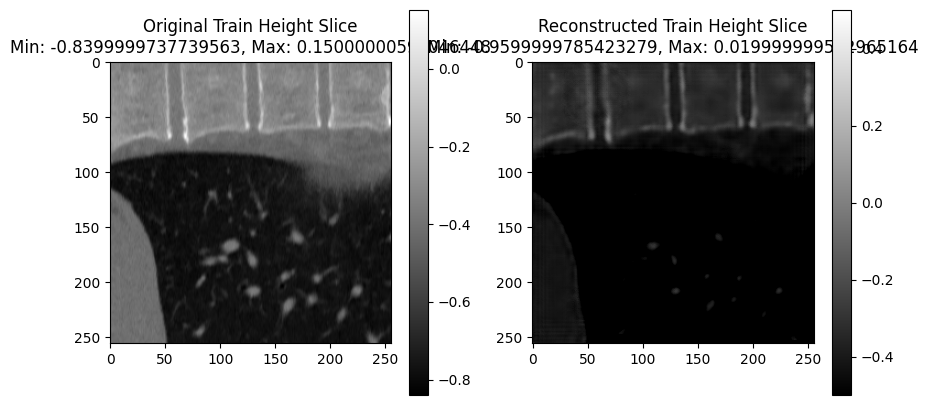

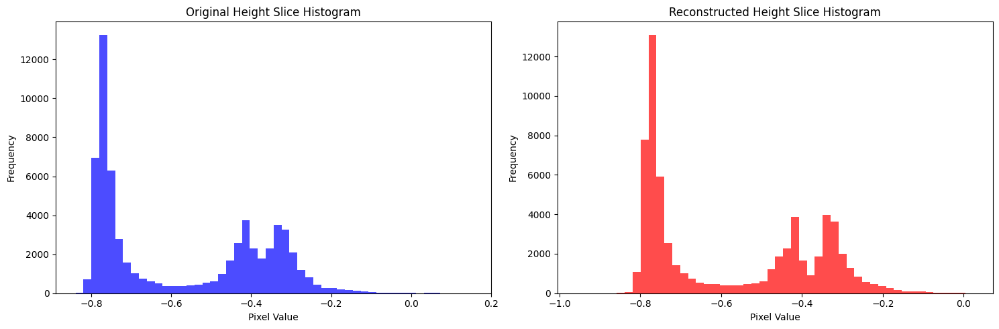

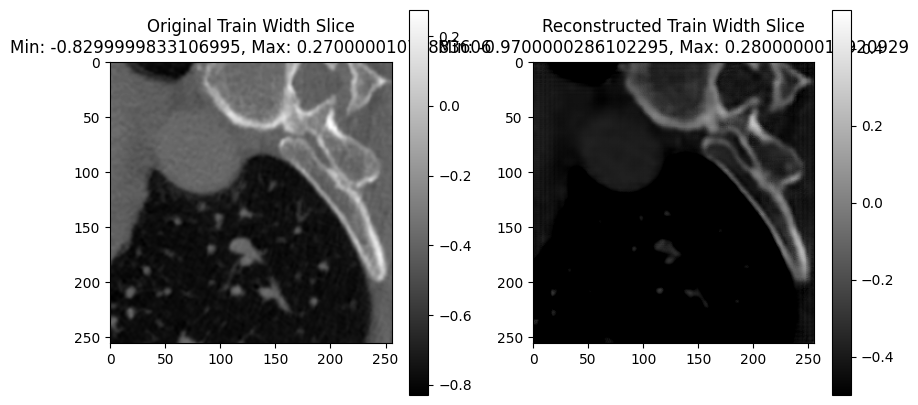

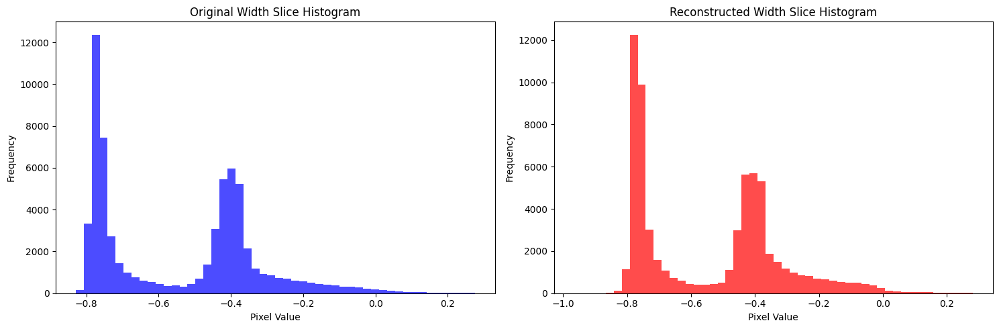

Validation: |          | 0/? [00:00<?, ?it/s]

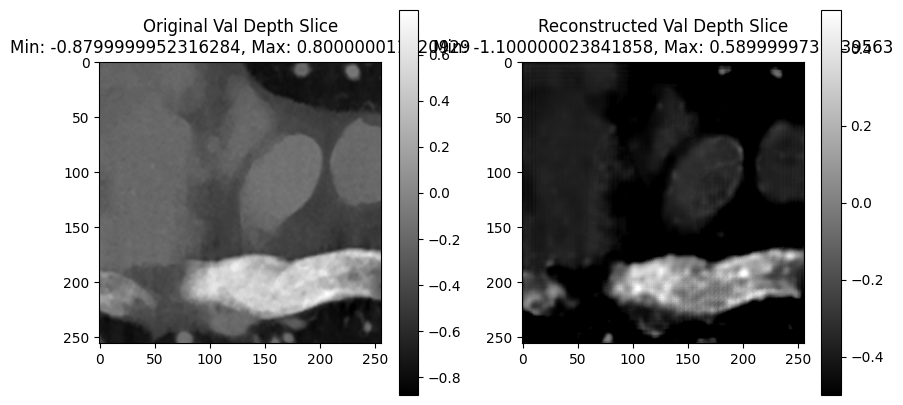

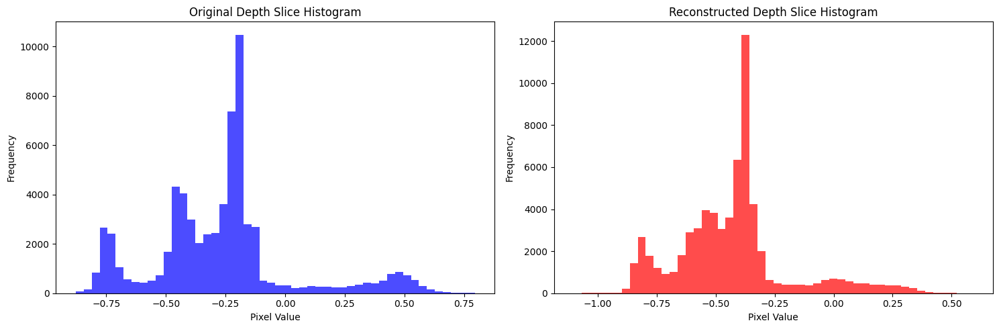

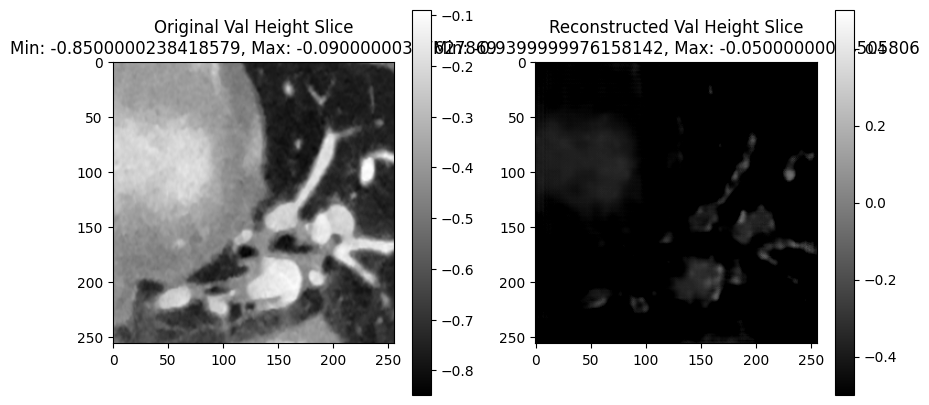

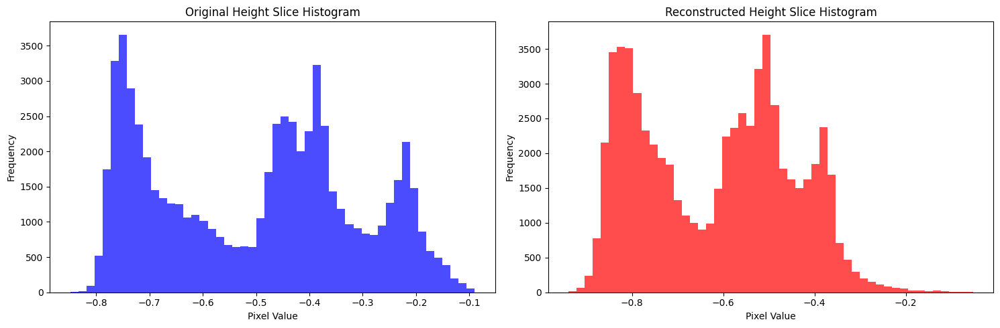

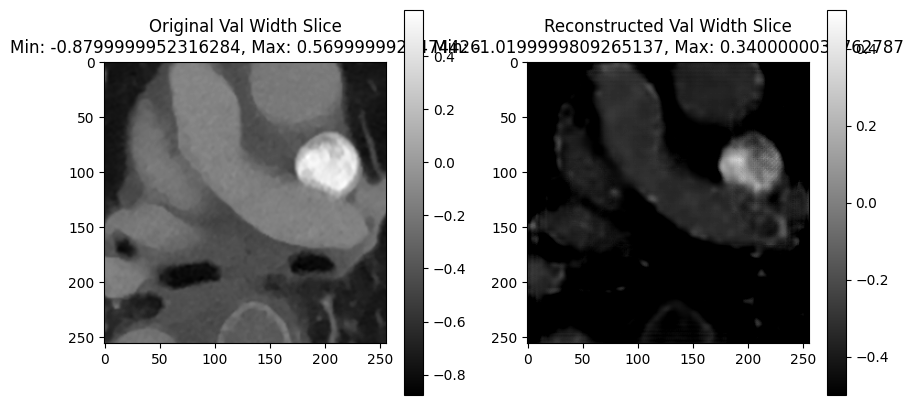

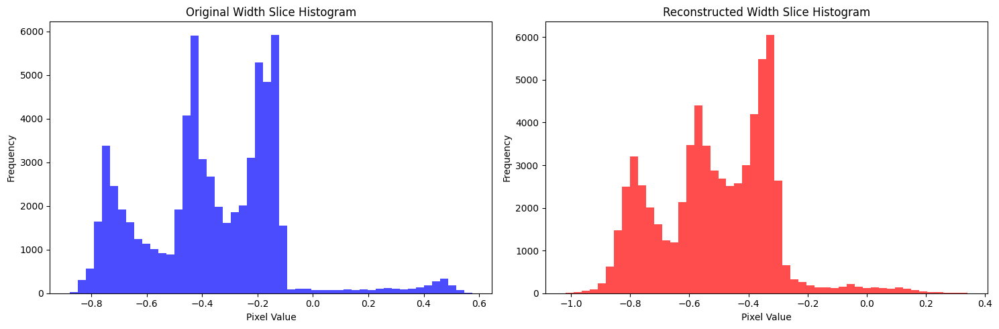

Time Spent 18903.91
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1387057      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job10 Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')